In [509]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

df = pd.read_csv("Montreal Crime Data.csv")
df.head()

,Unnamed: 0,category,date,postal_code,city,neighbourhood,year,count,longitude,latitude
0,0,Motor vehicle theft,2018-09-13,H1Z 1S9,MONTREAL,Saint-Michel,2018,1,-73.626,45.567
1,1,Motor vehicle theft,2018-04-30,H1Z 1S9,MONTREAL,Saint-Michel,2018,1,-73.626,45.567
2,2,Home Invasion,2018-01-10,H1Z 2V6,MONTREAL,Saint-Michel,2018,1,-73.629,45.569
3,3,Mischief,2018-11-12,H1Z 2V6,MONTREAL,Saint-Michel,2018,1,-73.629,45.569
4,4,Mischief,2018-08-15,H1Z 2V6,MONTREAL,Saint-Michel,2018,1,-73.629,45.569


In [2]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 136642 entries, 0 to 136641
Data columns (total 10 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Unnamed: 0     136642 non-null  int64  
 1   category       136642 non-null  object 
 2   date           136642 non-null  object 
 3   postal_code    136642 non-null  object 
 4   city           136642 non-null  object 
 5   neighbourhood  136642 non-null  object 
 6   year           136642 non-null  int64  
 7   count          136642 non-null  int64  
 8   longitude      136642 non-null  float64
 9   latitude       136642 non-null  float64
dtypes: float64(2), int64(3), object(5)
memory usage: 10.4+ MB


In [3]:
print("crime categories:", len(df.category.unique()))
print(df.category.unique())
print("municipality:", len(df.city.unique()))
print(df.city.unique())
print("neighbourhoods:", len(df.neighbourhood.unique()))
print(df.neighbourhood.unique())

crime categories: 6
['Motor vehicle theft' 'Home Invasion' 'Mischief'
 'Theft in / from a motor vehicle' 'Confirmed Theft'
 'Offenses resulting in death']
municipality: 28
['MONTREAL' 'SAINT-LAURENT' 'OUTREMONT' 'MONT-ROYAL' 'MONTREAL-NORD'
 'DORVAL' 'POINTE-CLAIRE' 'MONTREAL-EST' 'SAINT-LEONARD' 'COTE SAINT-LUC'
 'VERDUN' 'ANJOU' 'PIERREFONDS' 'DOLLARD-DES-ORMEAUX' 'WESTMOUNT'
 'LACHINE' "L'ILE-BIZARD" 'HAMPSTEAD' 'ROXBORO' 'POINTE-AUX-TREMBLES'
 'LASALLE' 'SAINTE-GENEVIEVE' 'KIRKLAND' 'MONTREAL-OUEST' 'BEACONSFIELD'
 'SAINTE-ANNE-DE-BELLEVUE' "BAIE-D'URFE" 'SENNEVILLE']
neighbourhoods: 51
['Saint-Michel' 'Saint-Laurent' 'Outremont' 'Montréal-Nord'
 "Dorval / L'Île-Dorval" 'Centre-Sud' 'Mercier' 'Petite-Patrie'
 'Old Montreal' 'Villeray' 'Rosemont' 'Ahuntsic' 'Parc-Extension'
 'Cartierville' 'Côte Saint-Luc' 'Pointe-Claire' 'Verdun' 'Hochelaga'
 'Saint-Léonard' 'Plateau Mont-Royal' 'Anjou' 'Dollard-des-Ormeaux'
 'Notre-Dame-de-Grâce' 'Maisonneuve' 'Westmount' 'Rivière-des-Prairies'
 '

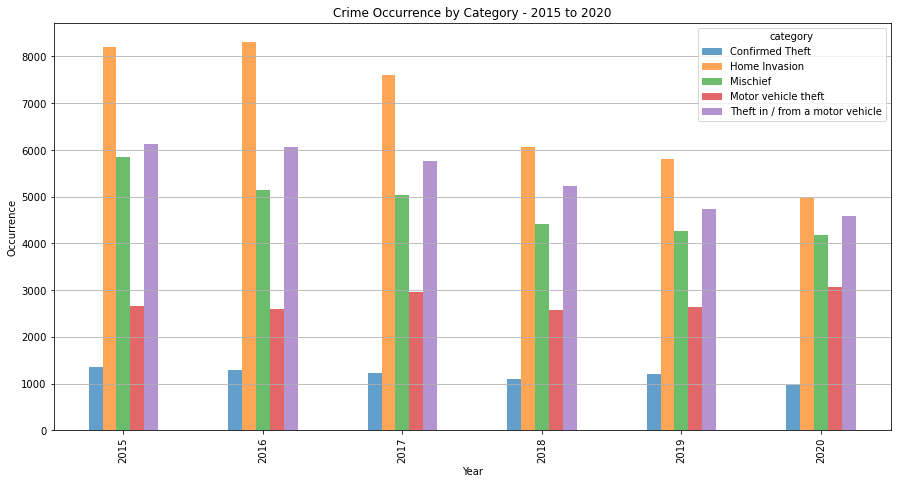

In [35]:
df2 = df.iloc[:,[1,6]].copy()
# remove negligible category
df2 = df2[(df2['category']!='Offenses resulting in death') & (df2.year!=2021)]

#df2['month'] = pd.DatetimeIndex(df2['date']).month
df2_year = df2.groupby(['year', 'category']).value_counts().unstack('category')
ax = df2_year.plot.bar(width=0.5, figsize=(15,7.5), alpha=0.7)
ax.grid('on', which='major', axis='y' )
ax.set_title("Crime Occurrence by Category - 2015 to 2020")
ax.set_xlabel("Year")
ax.set_ylabel("Occurrence")
plt.show()

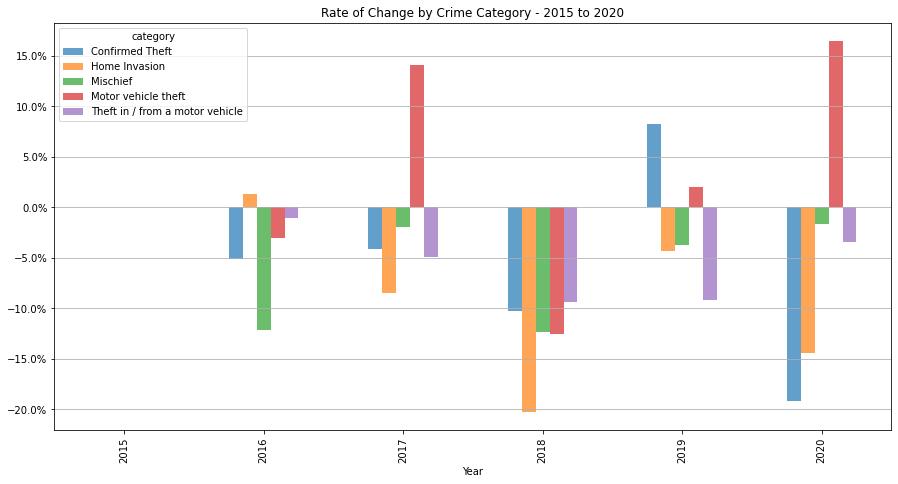

In [42]:
ax=(df2_year.pct_change()*100).plot.bar(width=0.5, figsize=(15,7.5), alpha=0.7)
ax.set_title("Rate of Change by Crime Category - 2015 to 2020")
ax.grid('on', which='major', axis='y' )
ax.set_xlabel("Year")
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()



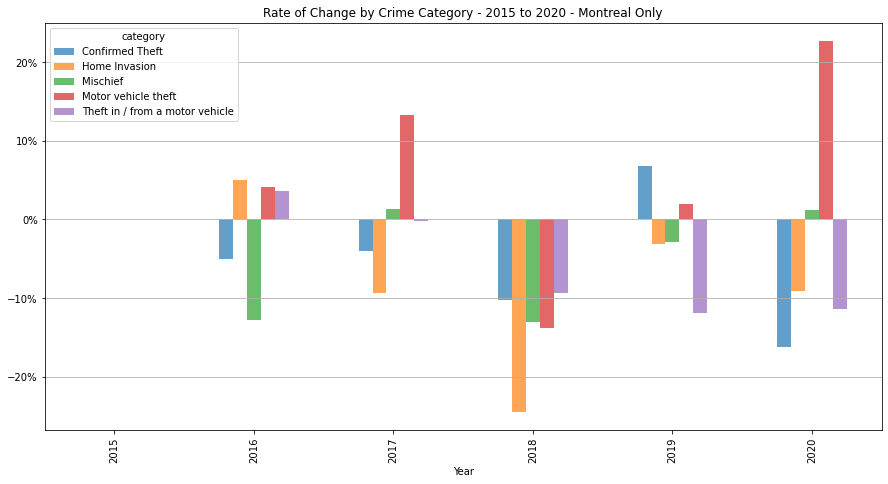

In [45]:
# Montreal only
df2 = df.iloc[:,[1,6]].copy()
# remove negligible category
df2 = df2[(df2['category']!='Offenses resulting in death') & (df2.year!=2021) & (df.city=='MONTREAL')]

df2_year = df2.groupby(['year', 'category']).value_counts().unstack('category')
ax=(df2_year.pct_change()*100).plot.bar(width=0.5, figsize=(15,7.5), alpha=0.7)
ax.set_title("Rate of Change by Crime Category - 2015 to 2020 - Montreal Only")
ax.grid('on', which='major', axis='y' )
ax.set_xlabel("Year")
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()


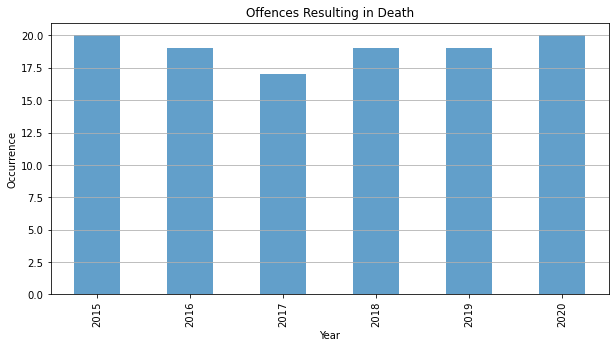

In [5]:
#df2_year = df2.groupby(['year', 'category']).value_counts().unstack('category')
#ax = df2_year.plot.bar(width=0.5, figsize=(15,7.5), alpha=0.7)
df2 = df.iloc[:,[1,6]].copy()

df2_death = df2[(df2['category']=='Offenses resulting in death') & (df2.year!=2021)]
df2_death = df2_death.groupby(['year']).value_counts().unstack('category')
df2_death
ax = df2_death.plot.bar(width=0.5, figsize=(10,5), alpha=0.7, legend=False)
ax.grid('on', which='major', axis='y' )
ax.set_title("Offences Resulting in Death")
ax.set_xlabel("Year")
ax.set_ylabel("Occurrence")
plt.show()

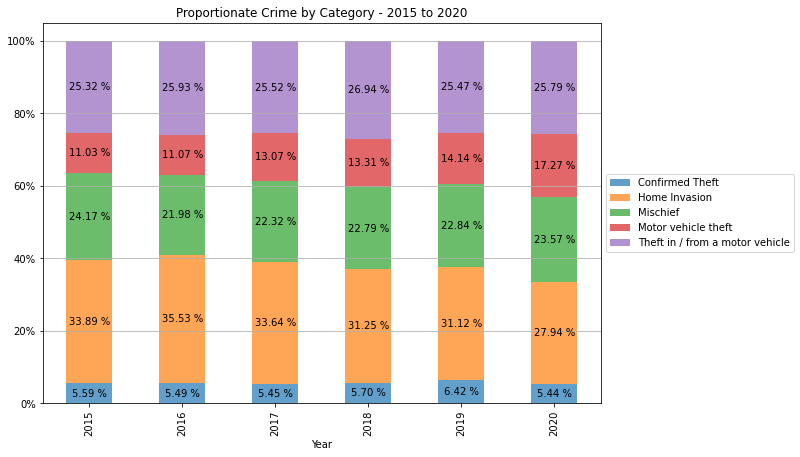

In [33]:
import matplotlib.ticker as mtick

df2 = df.iloc[:,[1,6]].copy()
# remove negligible category
df2 = df2[(df2['category']!='Offenses resulting in death') & (df2.year!=2021)]

df2_year = df2.groupby(['year']).value_counts(normalize=True).unstack('category')*100
ax = df2_year.plot.bar(width=0.5, figsize=(10,7), alpha=0.7, stacked=True) #plot(kind='bar', stacked=True)
ax.grid('on', which='major', axis='y' )
ax.set_title("Proportionate Crime by Category - 2015 to 2020")
ax.set_xlabel("Year")

ax.yaxis.set_major_formatter(mtick.PercentFormatter())

#ax.set_ylim(0,150)
#ax = percentage_dist.plot.bar(stacked=True)

# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    ax.text(x+width/2, 
            y+height/2, 
            '{:.2f} %'.format(height), 
            horizontalalignment='center', 
            verticalalignment='center')
    
plt.show()

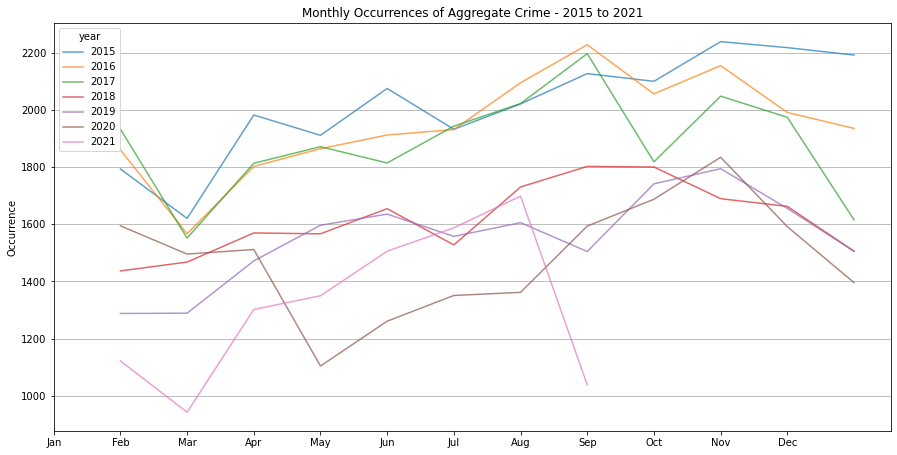

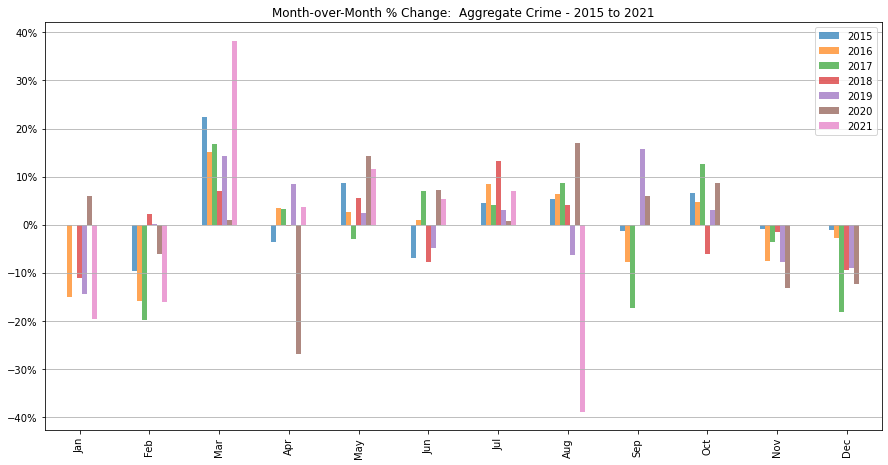

In [7]:
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

df2 = df.iloc[:,[6]].copy()
df2['month'] = pd.DatetimeIndex(df['date']).month
df2 = df2.groupby(['year', 'month']).value_counts().unstack('year')
df2

# calculate and graph occurrence data ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
ax = df2.plot(figsize=(15,7.5), alpha=0.7)
plt.xticks(np.arange(0, 12, 1.0))
ax.set_xticklabels(months)
ax.set_xlabel("")
ax.set_ylabel("Occurrence")
ax.grid('on', which='major', axis='y' )
ax.set_title("Monthly Occurrences of Aggregate Crime - 2015 to 2021")
plt.show()
# calculate and graph occurrence data ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

# calculate and graph M-o-M percent change ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# get last (Dec) row to calculate following month (Jan) change
temp = ( df2.iloc[-1:] )
temp = list(temp.iloc[0])
temp2 = temp.copy()
temp2[0] = temp[-1]
temp2[1:] = temp[:-1]

# reinsert row to the first position of the dataframe
#df3 = df2.copy()
df2.index = list(range(1,13))
df2.loc[0] = temp2
df2.sort_index(inplace=True)

# calculate M-o-M percent change
df2_pc = pd.DataFrame()
for col in df2:
    df2_pc[col] = ( list( df2[col].pct_change()*100 ) )

# Drop first row (all NaN)
df2_pc.drop(index=df.index[0], axis=0, inplace=True)

# graph M-o-M change
ax = df2_pc.plot.bar(figsize=(15,7.5), alpha=0.7)
ax.set_xticklabels(months)
ax.set_xlabel("")
ax.set_ylabel("")
ax.grid('on', which='major', axis='y' )
ax.set_title("Month-over-Month % Change:  Aggregate Crime - 2015 to 2021")
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()
# calculate and graph M-o-M percent change ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

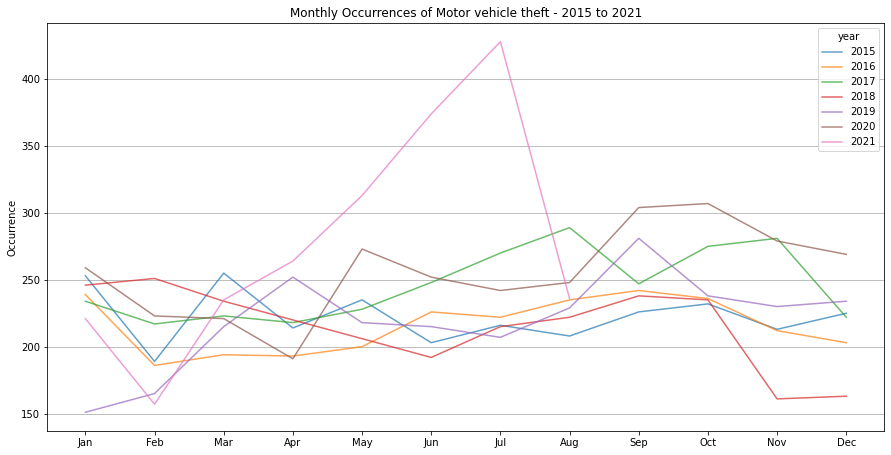

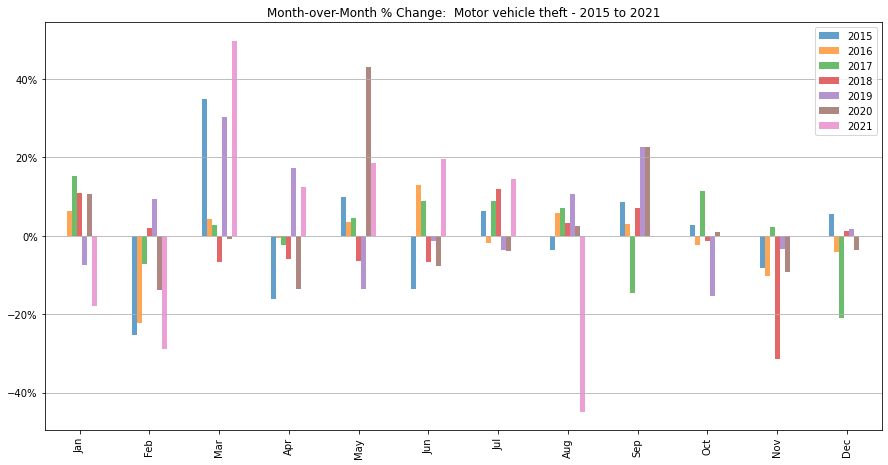

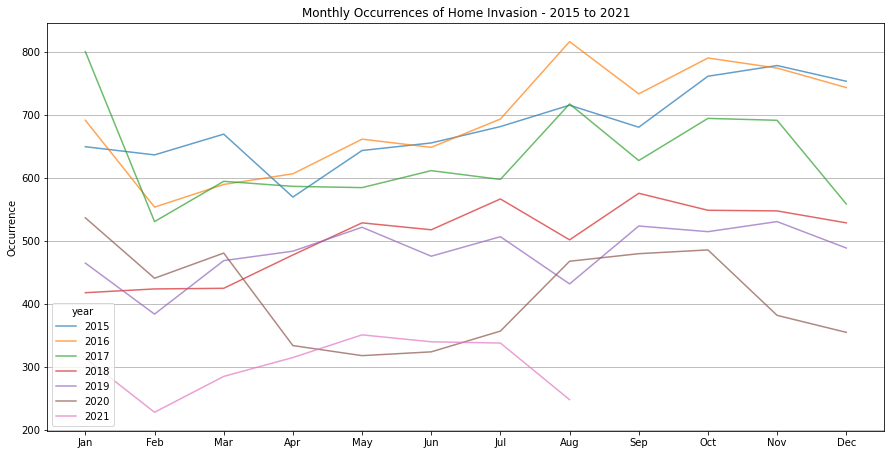

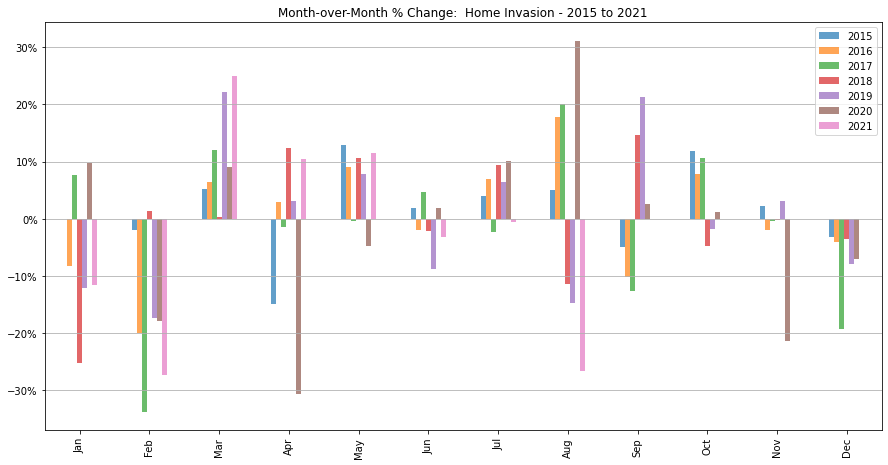

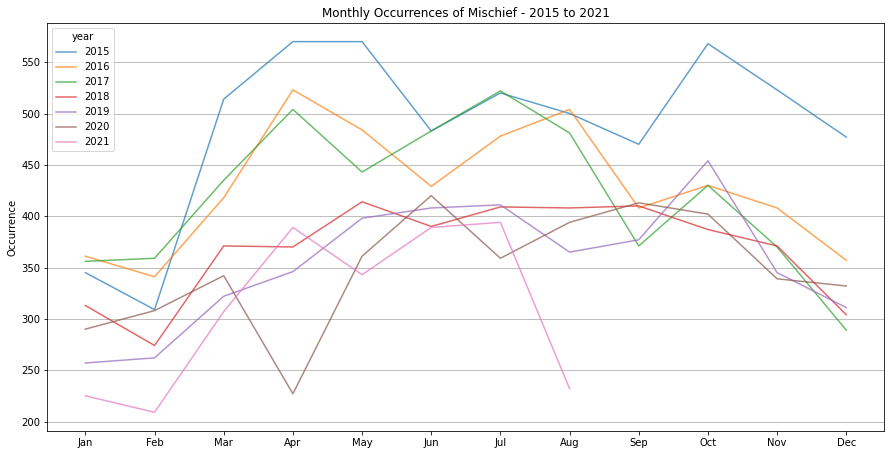

...

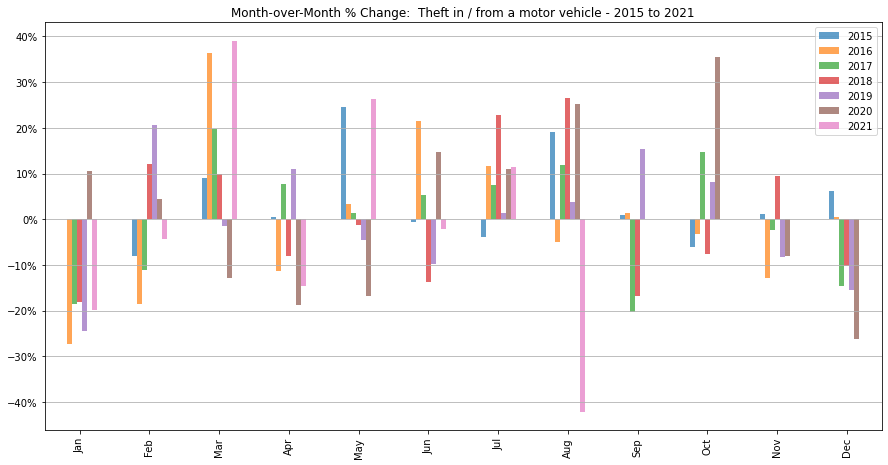

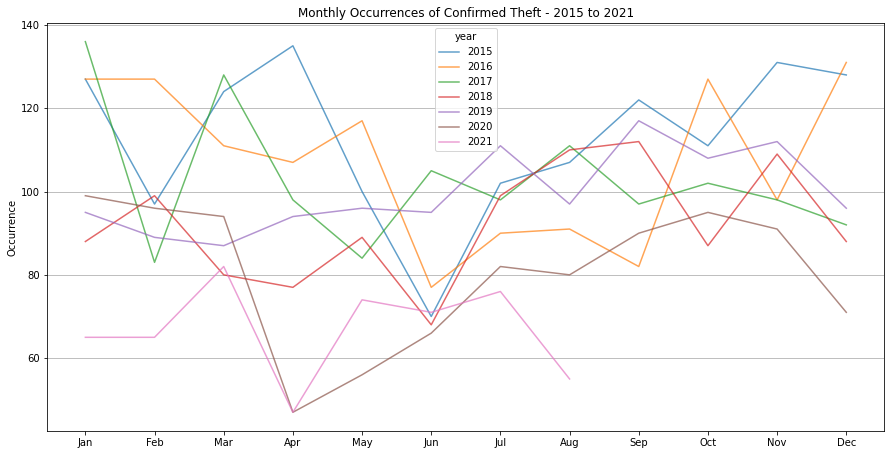

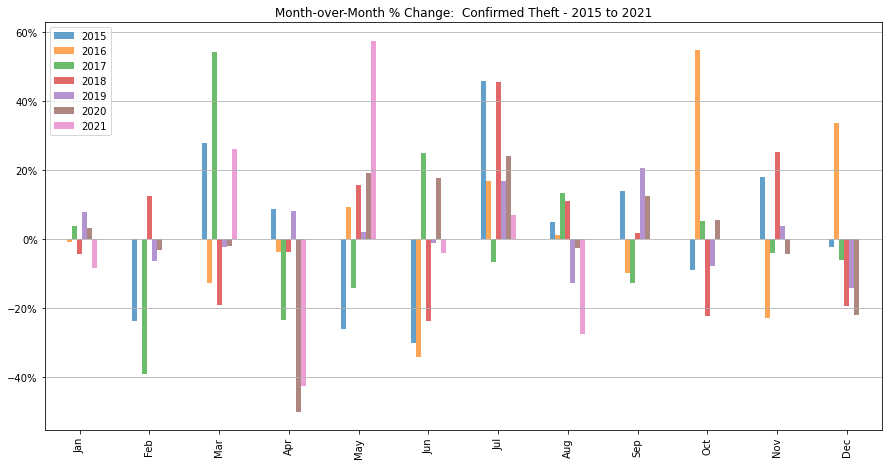

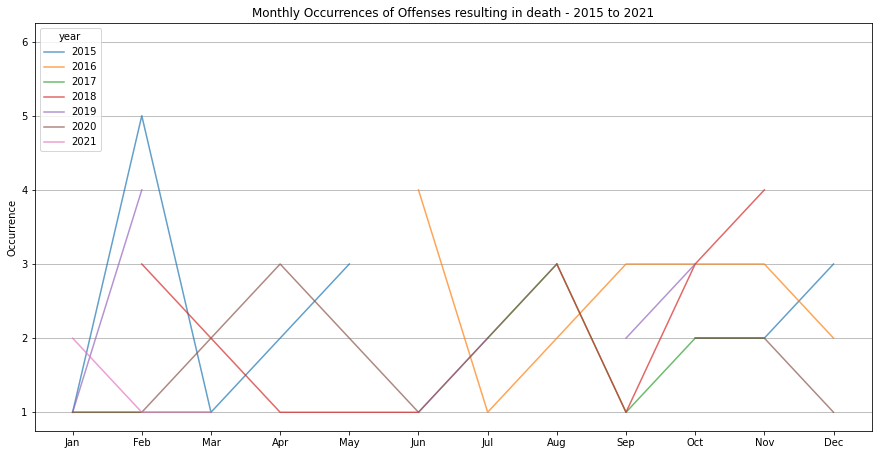

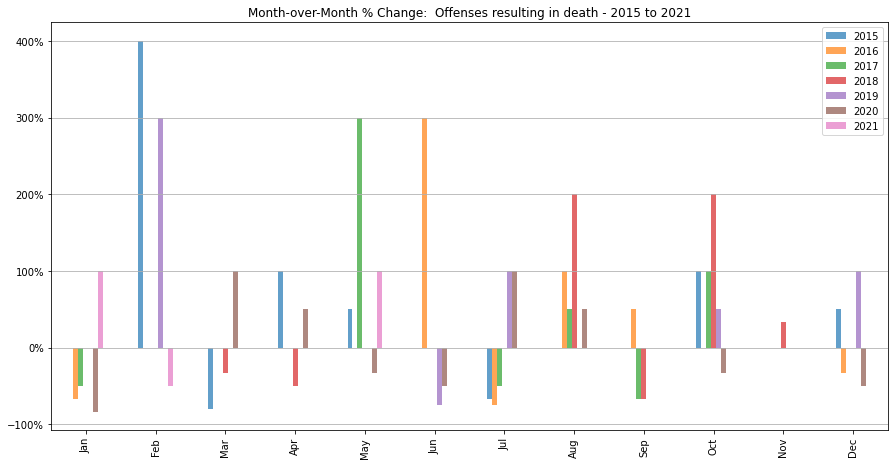

In [8]:
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

for crime_cat in df.category.unique():
    
    df2 = df.iloc[:,[1,6]].copy()
    df2['month'] = pd.DatetimeIndex(df['date']).month
    
    # calculate and graph occurrence data ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    crime = crime_cat
    df2 = df2[(df2.category==crime)].groupby(['year', 'month']).value_counts().unstack('year')
    ax = df2.plot(figsize=(15,7.5), alpha=0.7)
    plt.xticks(np.arange(0, 12, 1.0))
    ax.set_xticklabels(months)
    ax.set_xlabel("")
    ax.set_ylabel("Occurrence")
    ax.grid('on', which='major', axis='y' )
    ax.set_title("Monthly Occurrences of " + crime + " - 2015 to 2021")
    plt.show()
    # calculate and graph occurrence data ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    # calculate and graph M-o-M percent change ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    # get last (Dec) row to calculate following month (Jan) change
    temp = ( df2.iloc[-1:] )
    temp = list(temp.iloc[0])
    temp2 = temp.copy()
    temp2[0] = temp[-1]
    temp2[1:] = temp[:-1]

    # reinsert row to the first position of the dataframe
    #df3 = df2.copy()
    df2.index = list(range(1,13))
    df2.loc[0] = temp2
    df2.sort_index(inplace=True)

    # calculate M-o-M percent change
    df2_pc = pd.DataFrame()
    for col in df2:
        df2_pc[col] = ( list( df2[col].pct_change()*100 ) )

    # Drop first row (all NaN)
    df2_pc.drop(index=df.index[0], axis=0, inplace=True)

    # graph M-o-M change
    ax = df2_pc.plot.bar(figsize=(15,7.5), alpha=0.7)
    ax.set_xticklabels(months)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.grid('on', which='major', axis='y' )
    ax.set_title("Month-over-Month % Change:  " + crime + " - 2015 to 2021")
    ax.yaxis.set_major_formatter(mtick.PercentFormatter())
    plt.show()
    # calculate and graph M-o-M percent change ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

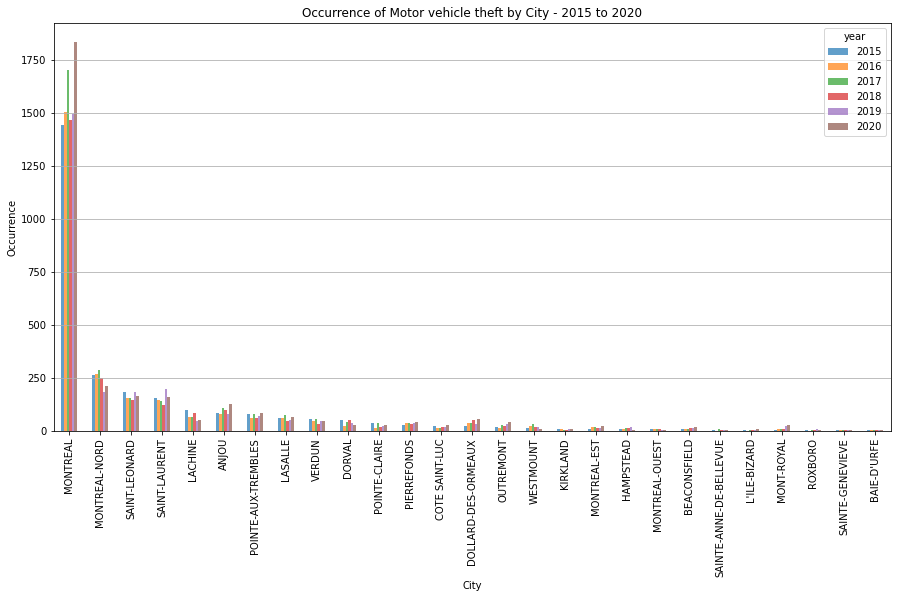

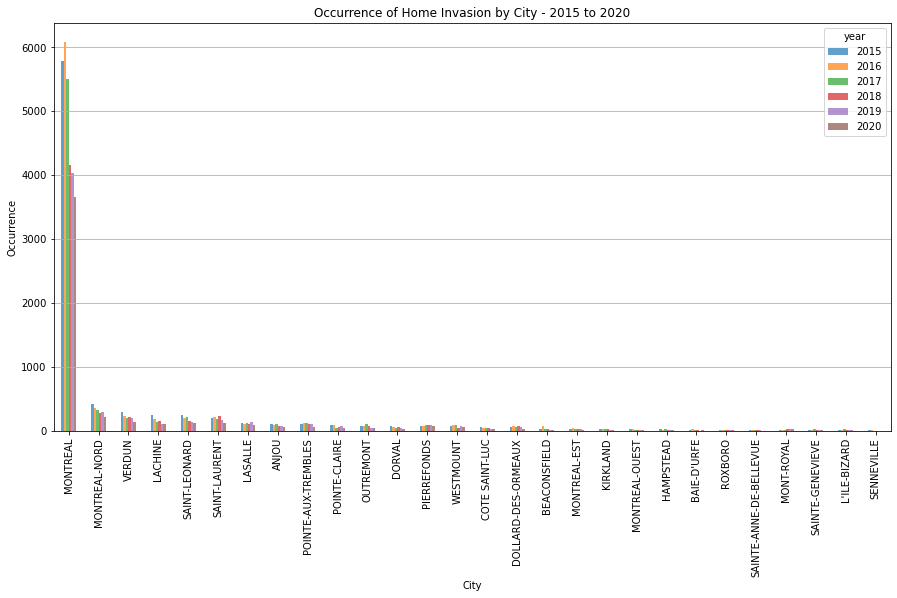

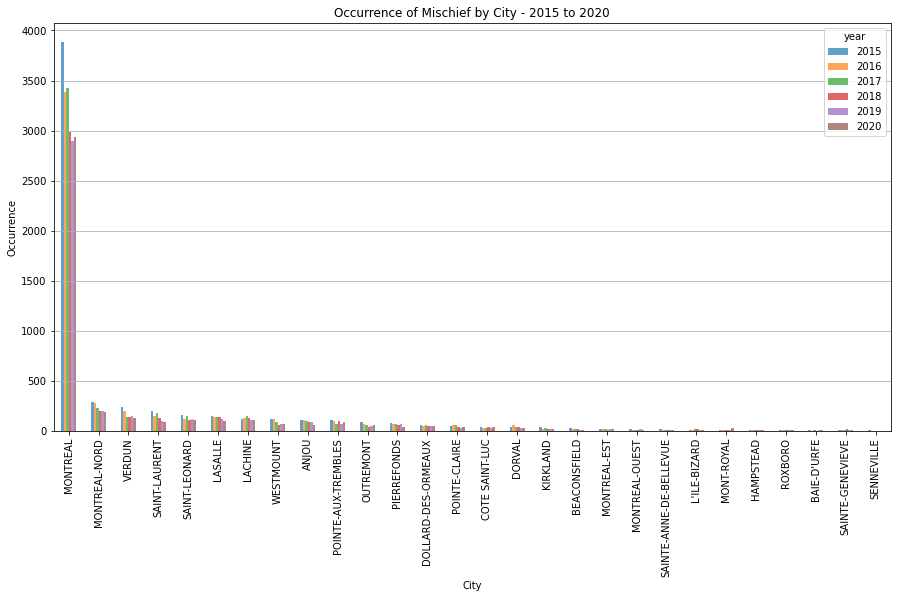

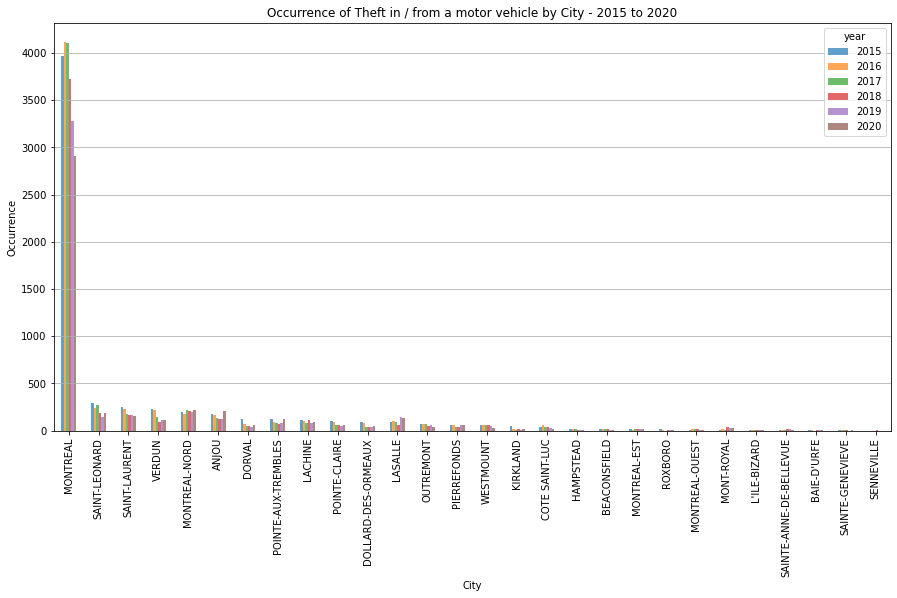

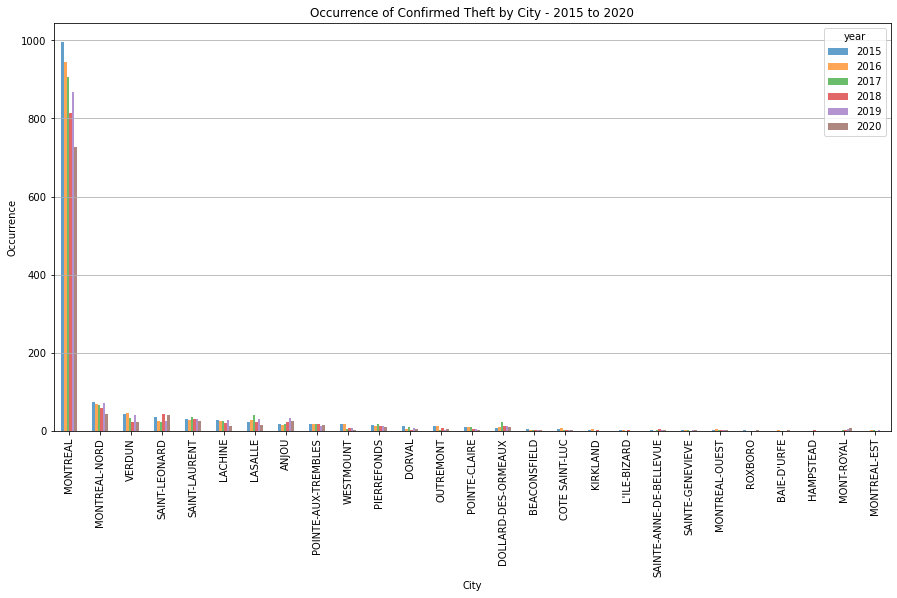

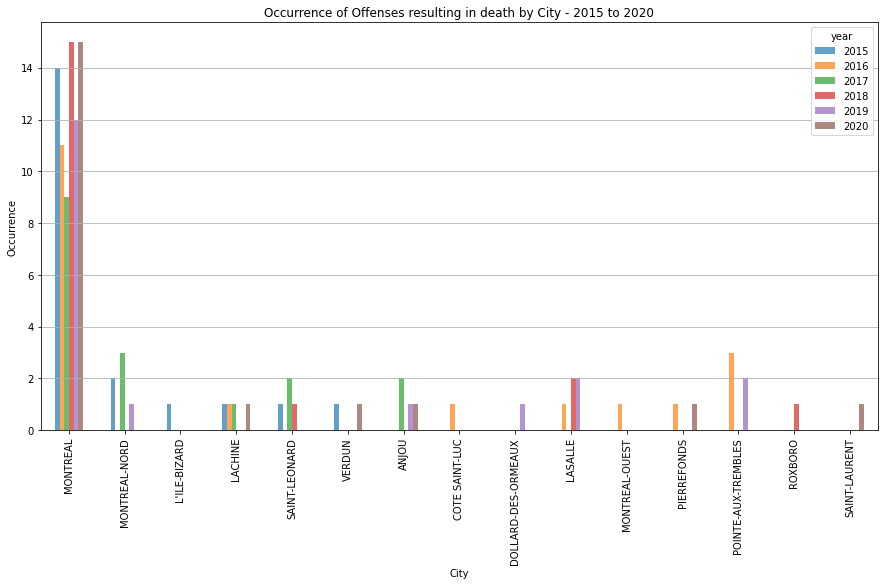

In [9]:
# crime by city
for crime in df.category.unique():
    df2 = df[(df.category==crime) & (df.year!=2021)].iloc[:,[4,6]].groupby(['city']).value_counts().unstack('year')
    df2 = df2.sort_values(by=df2.columns[0], ascending=False)
    
    ax = df2.plot.bar(width=0.5, figsize=(15,7.5), alpha=0.7)
    ax.grid('on', which='major', axis='y' )
    ax.set_title("Occurrence of " + crime + " by City - 2015 to 2020")
    ax.set_xlabel("City")
    ax.set_ylabel("Occurrence")
    plt.show()

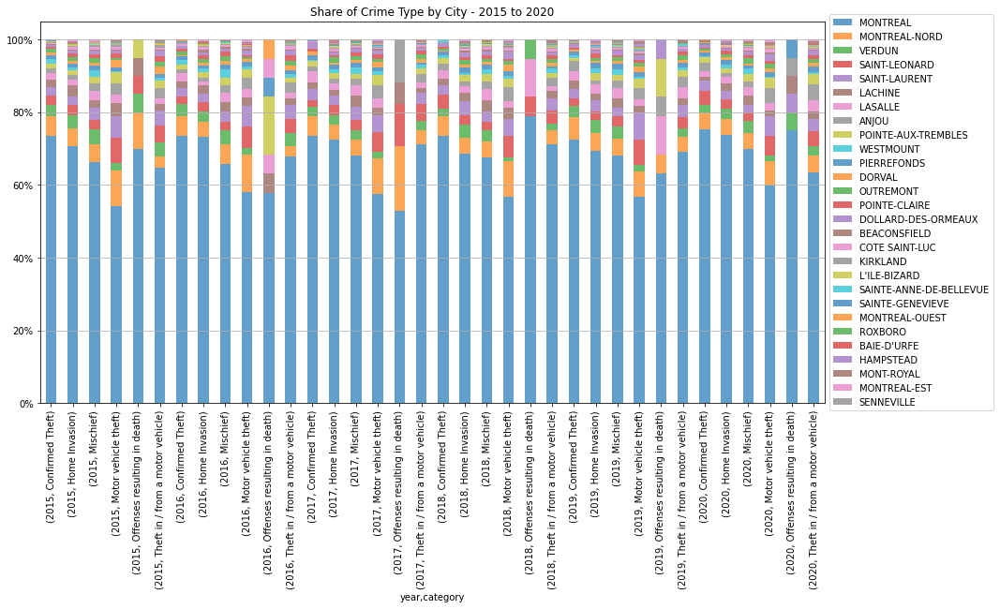

In [10]:
# crime by city
#for crime in df.category.unique():

df2 = df[(df.year!=2021)].iloc[:,[1,4,6]].groupby(['year', 'category']).value_counts(normalize=True).unstack('city')*100
df2 = df2.sort_values(axis=1, by=df2.index[0], ascending=False)

ax = df2.plot.bar(width=0.5, figsize=(15,7.5), alpha=0.7, stacked=True)
ax.grid('on', which='major', axis='y' )
ax.set_title("Share of Crime Type by City - 2015 to 2020")
ax.yaxis.set_major_formatter(mtick.PercentFormatter())

# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

plt.show()

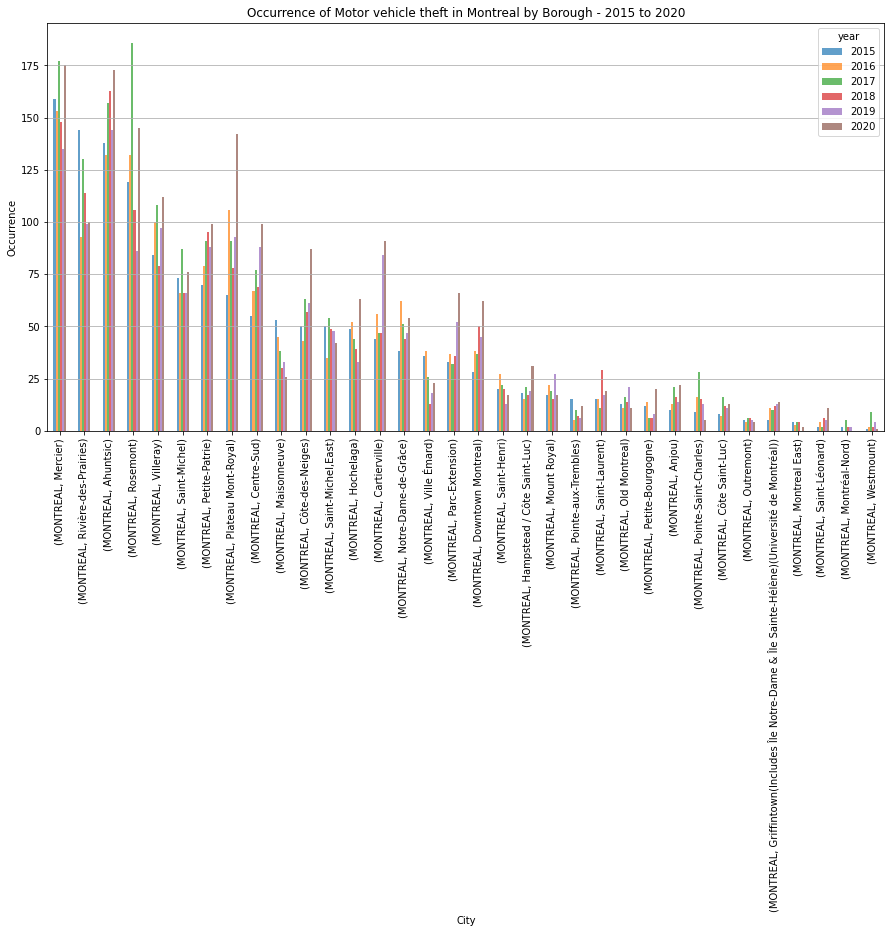

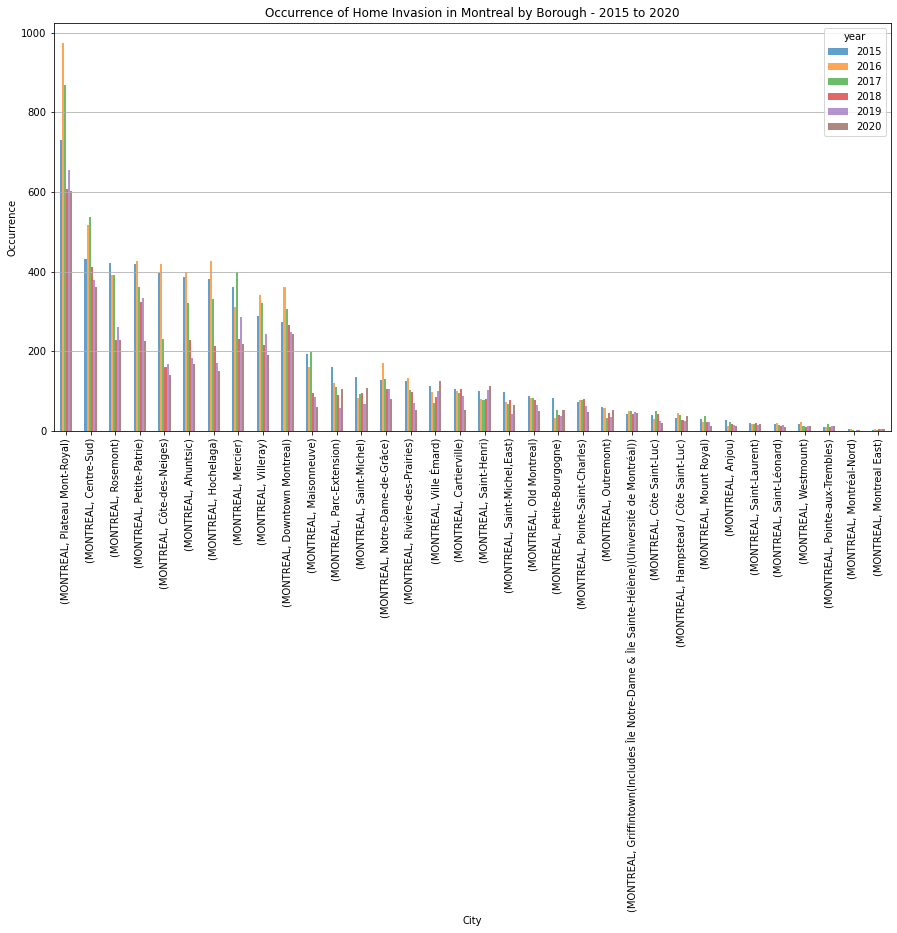

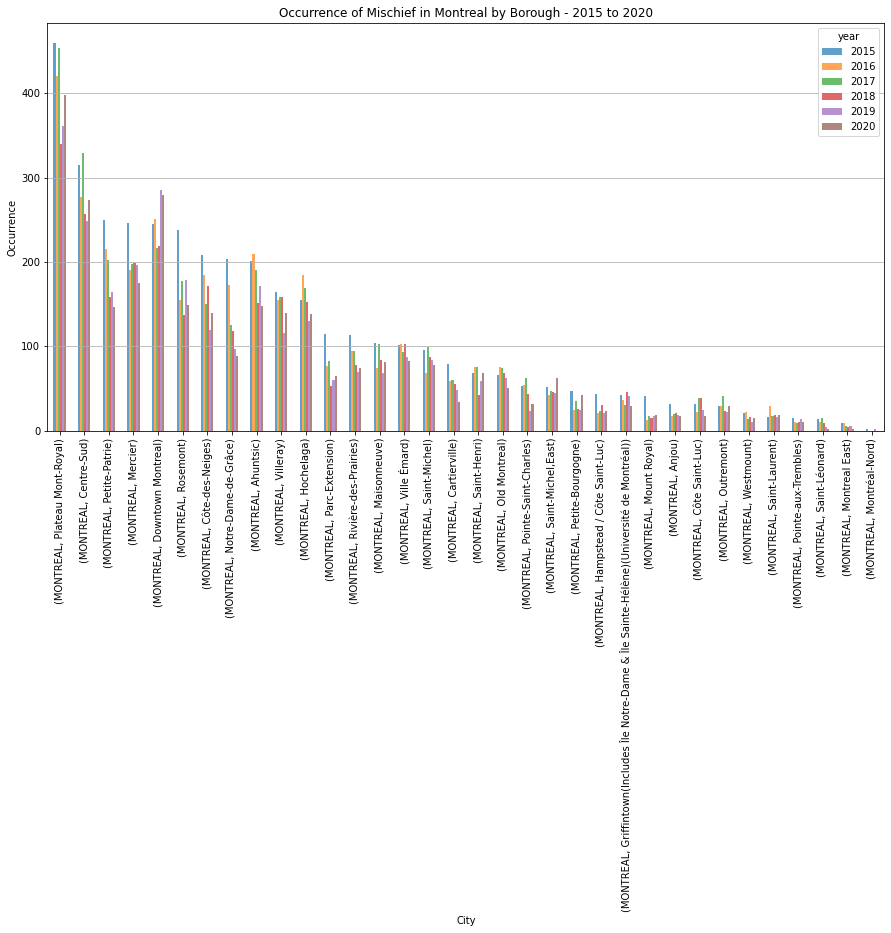

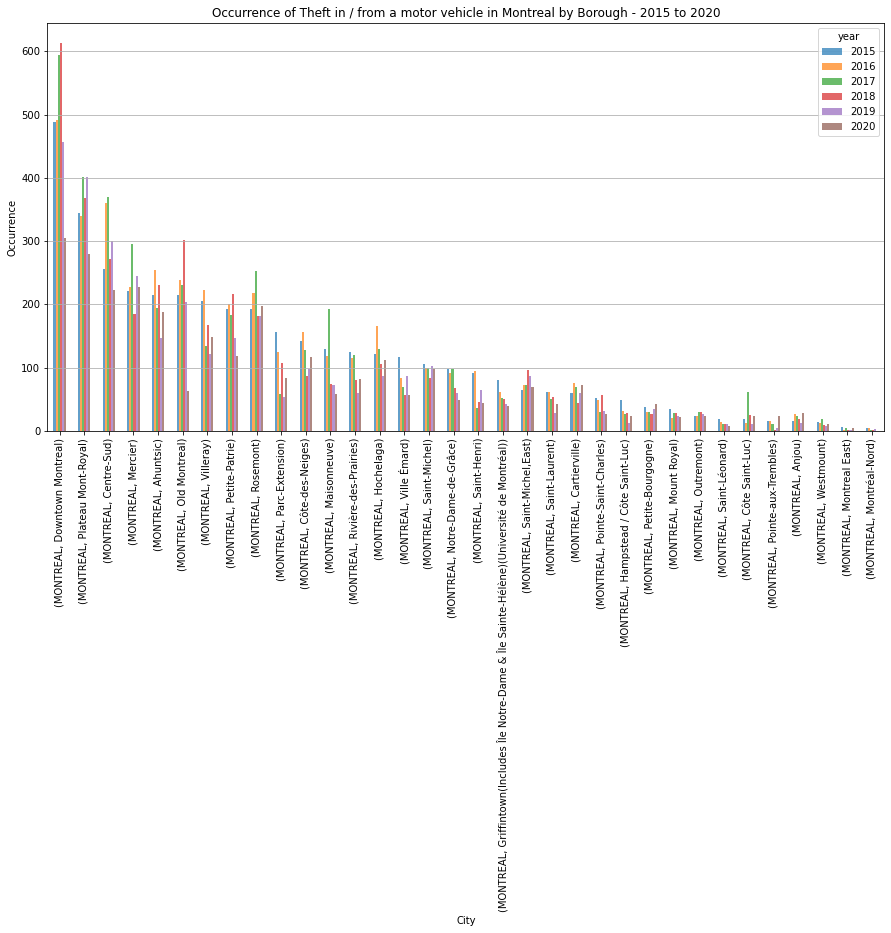

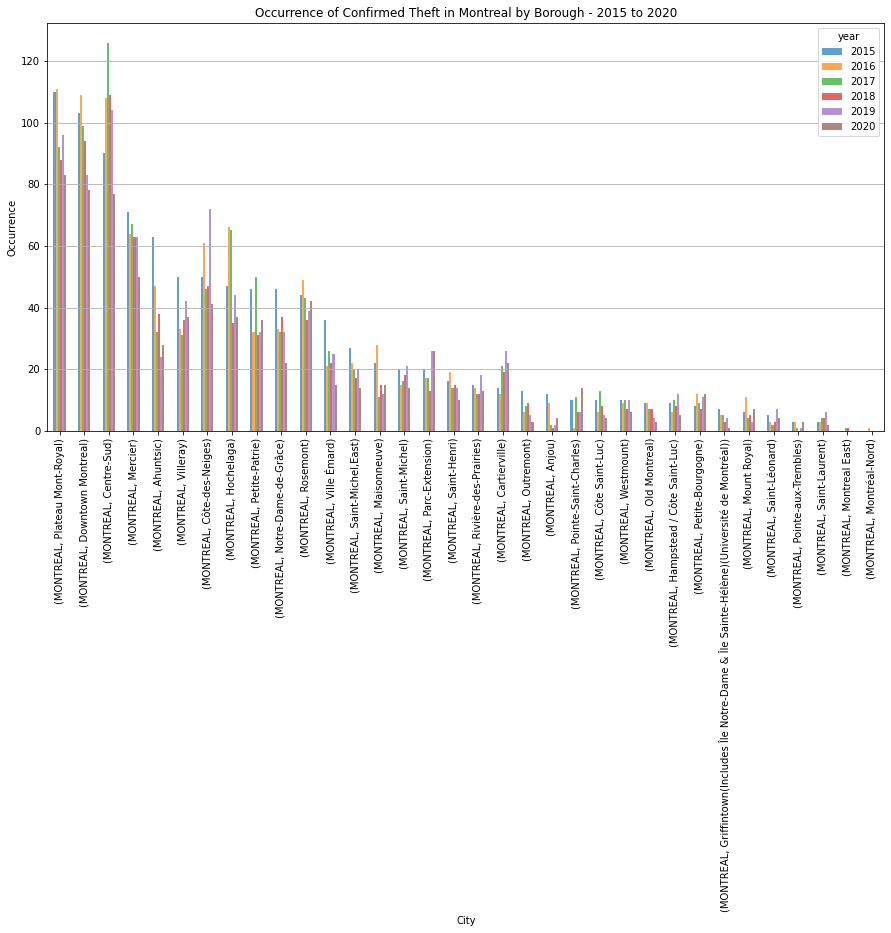

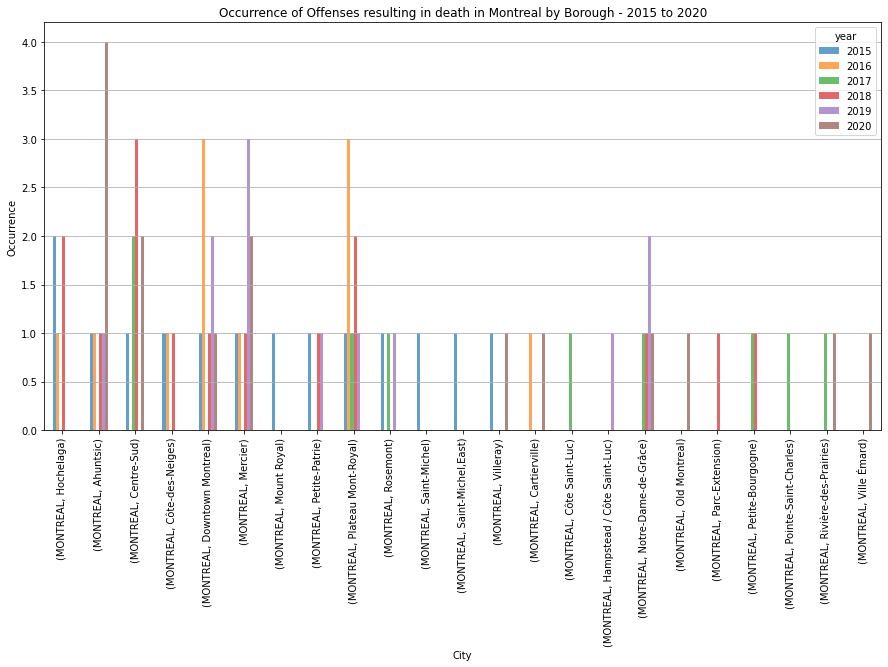

In [32]:
# crime by Montreal borough 
for crime in df.category.unique():
    df2 = df[(df.category==crime) & (df.year!=2021) & (df.city=='MONTREAL')].iloc[:,[4,5,6]].groupby(['city']).value_counts().unstack('year')
    df2 = df2.sort_values(by=df2.columns[0], ascending=False)

    ax = df2.plot.bar(width=0.5, figsize=(15,7.5), alpha=0.7)
    ax.grid('on', which='major', axis='y' )
    ax.set_title("Occurrence of " + crime + " in Montreal by Borough - 2015 to 2020")
    ax.set_xlabel("City")
    ax.set_ylabel("Occurrence")
    plt.show()

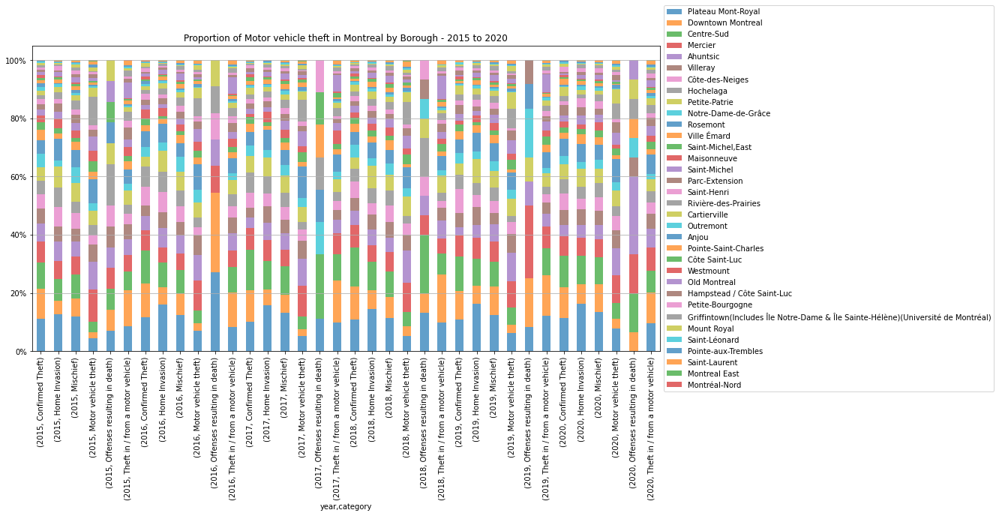

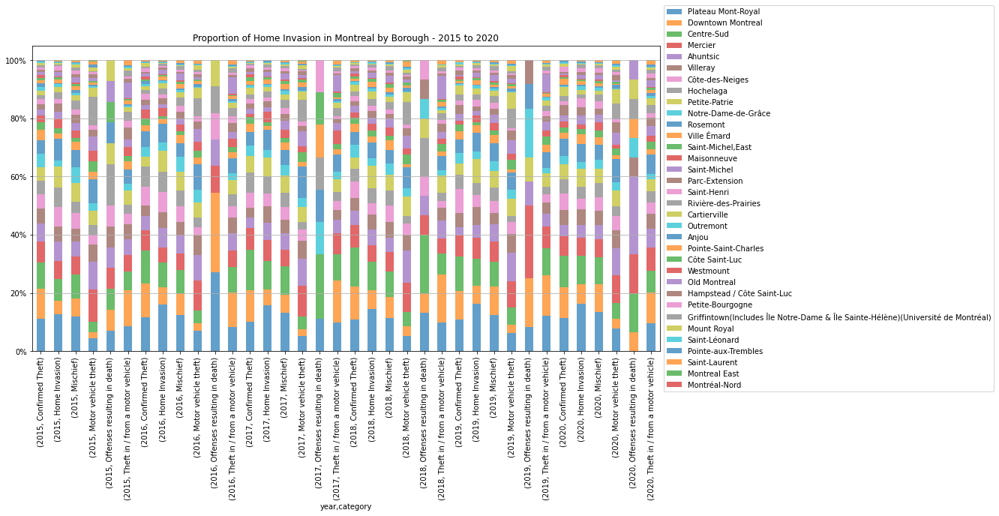

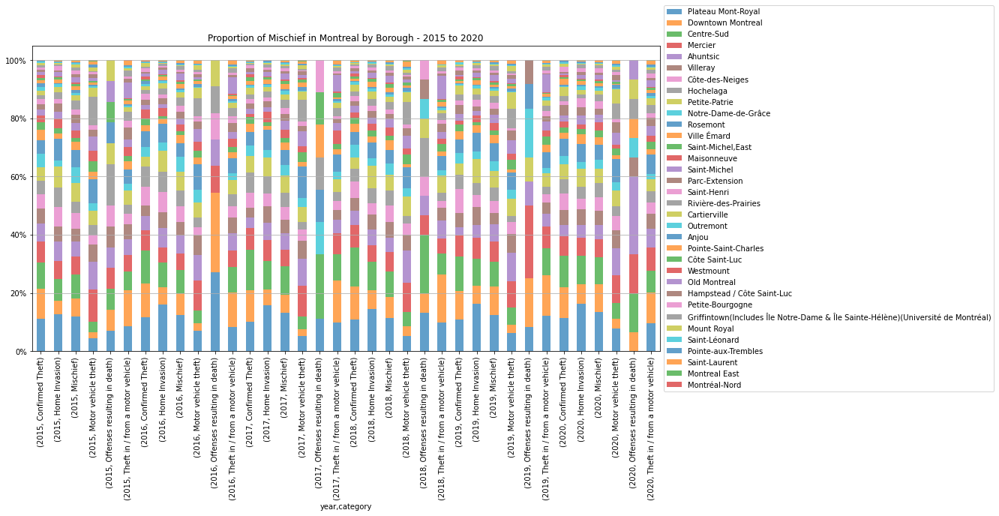

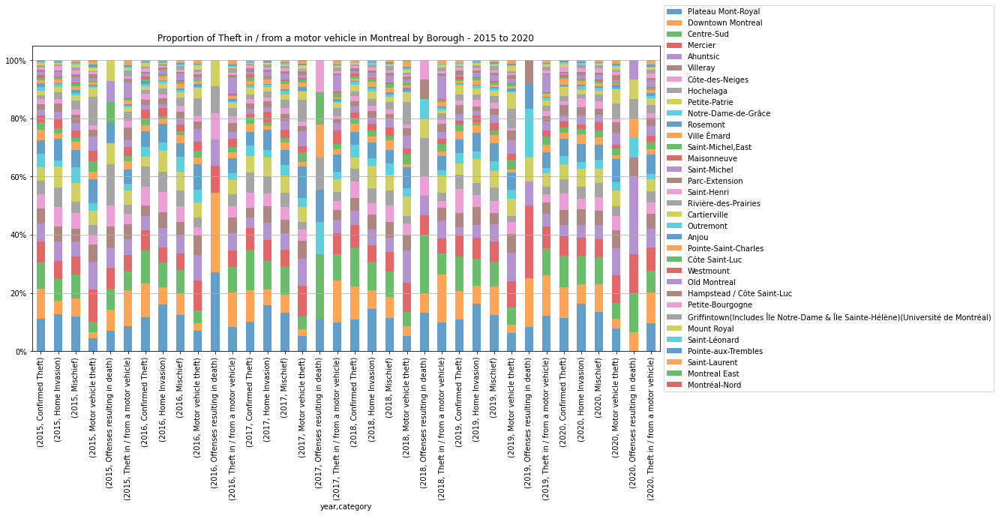

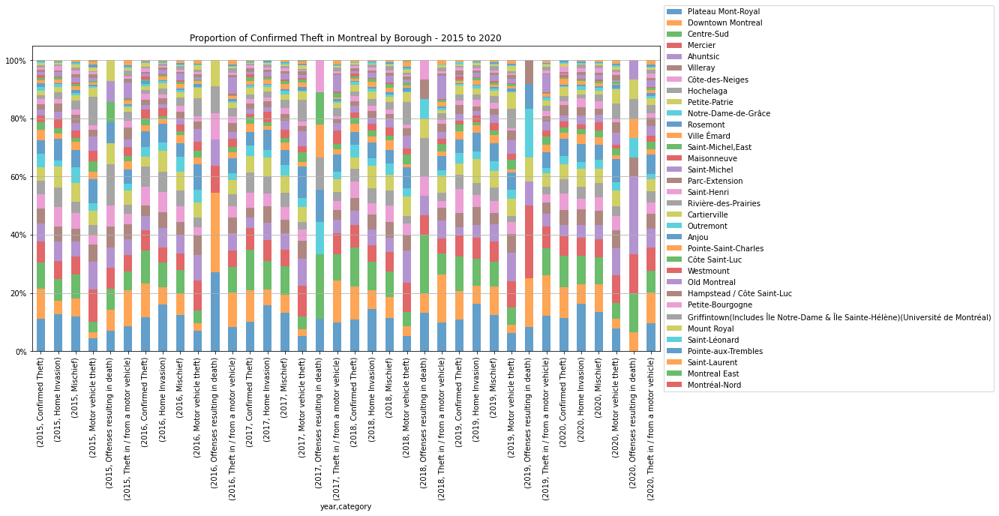

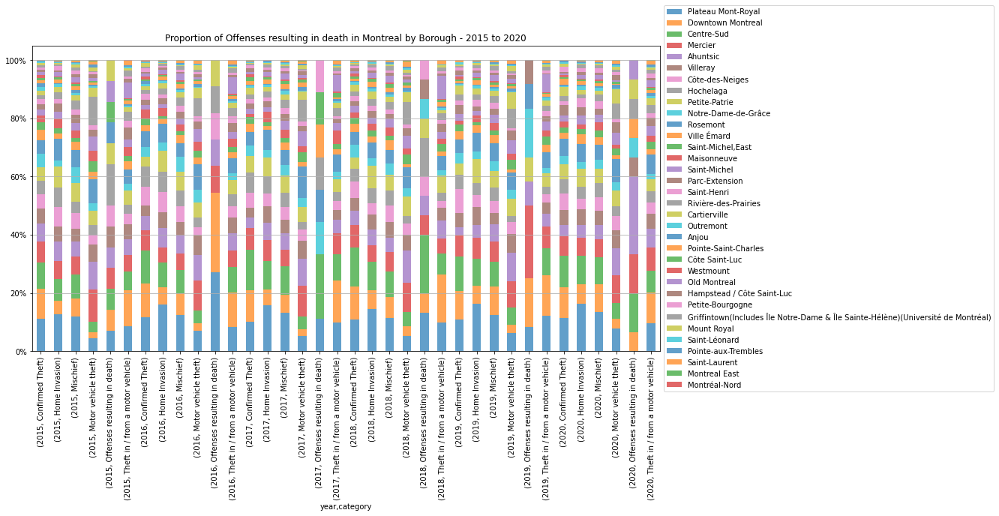

In [34]:
# crime by Montreal borough

for crime in df.category.unique():
    df2 = df[(df.year!=2021) & (df.city=='MONTREAL')].iloc[:,[1,5,6]].groupby(['year', 'category']).value_counts(normalize=True).unstack('neighbourhood')*100
    df2 = df2.sort_values(axis=1, by=df2.index[0], ascending=False)

    ax = df2.plot.bar(width=0.5, figsize=(15,7.5), alpha=0.7, stacked=True)
    ax.grid('on', which='major', axis='y' )
    ax.set_title("Proportion of " + crime + " in Montreal by Borough - 2015 to 2020")
    ax.yaxis.set_major_formatter(mtick.PercentFormatter())

    # Put a legend above current axis
    #ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.05),
    #          ncol=3, fancybox=True, shadow=True)

    # Put a legend to the right of the current axis
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.show()

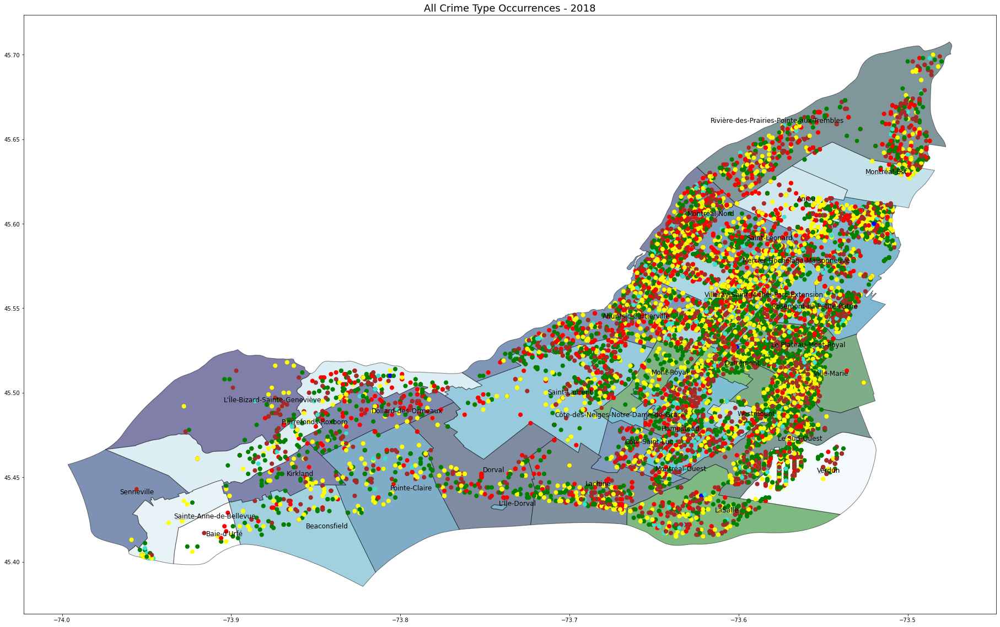

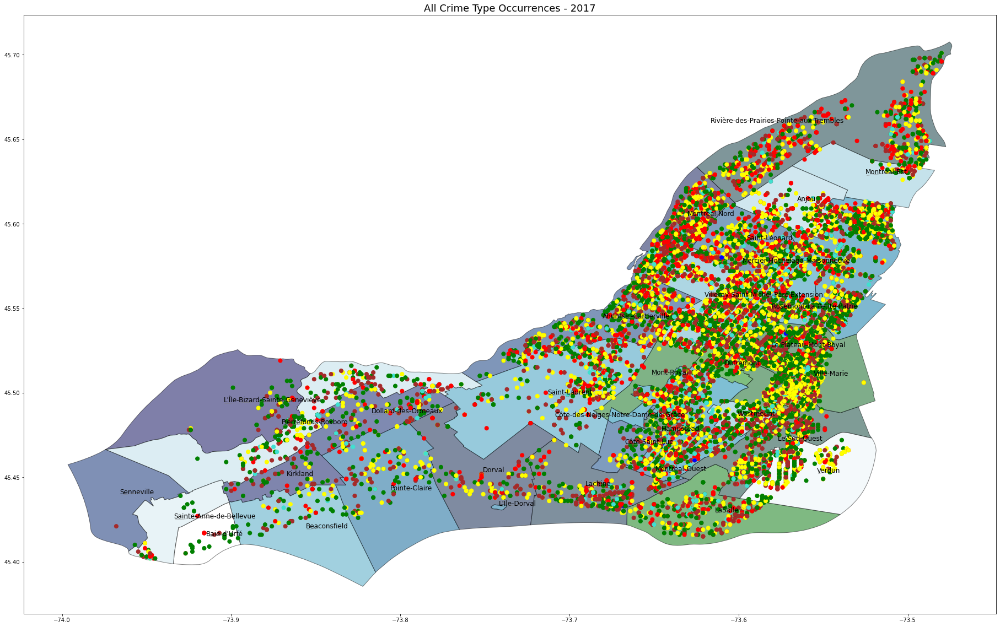

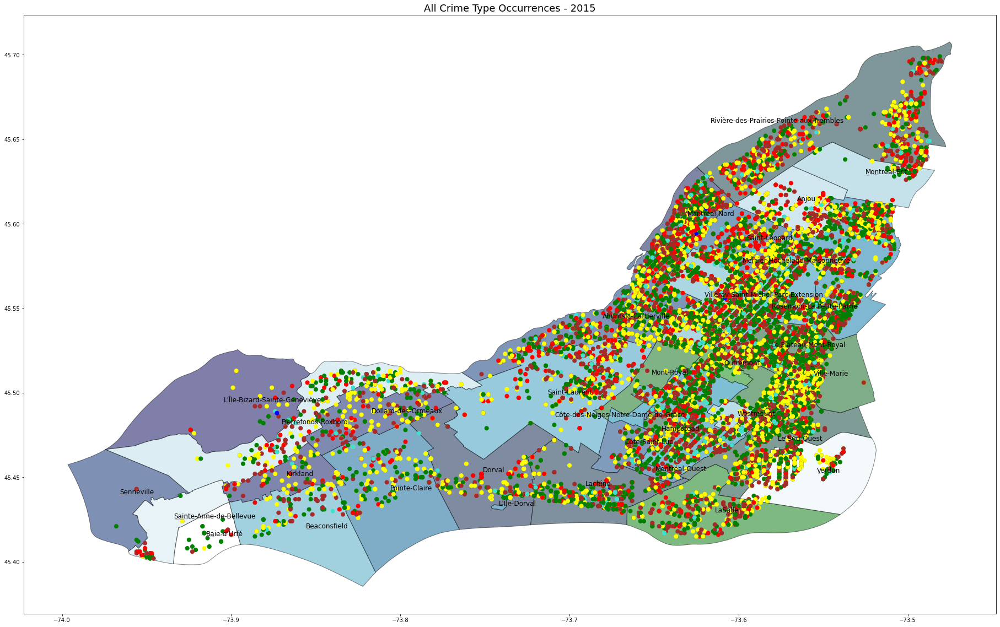

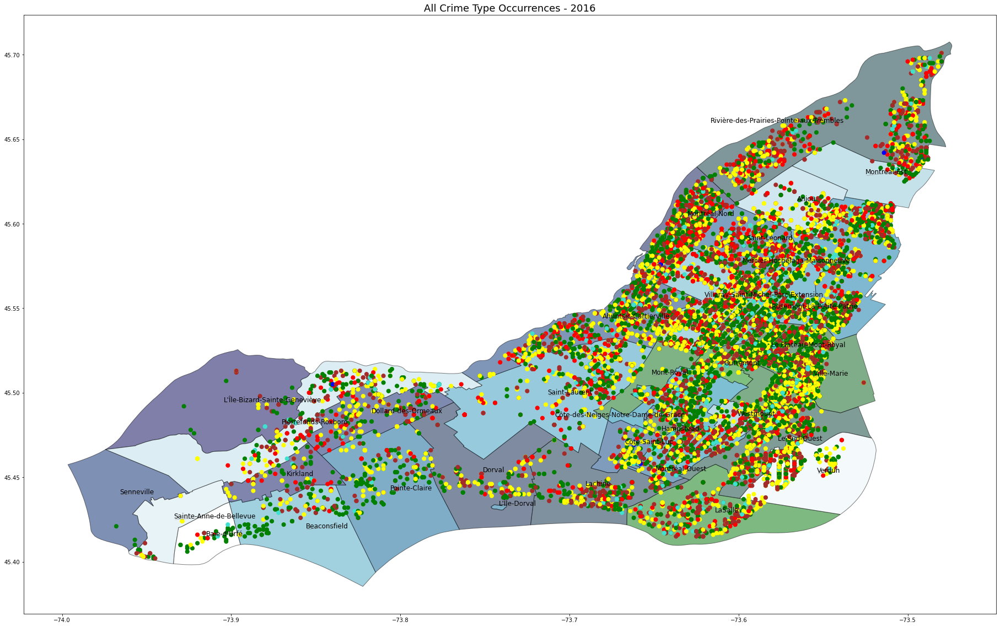

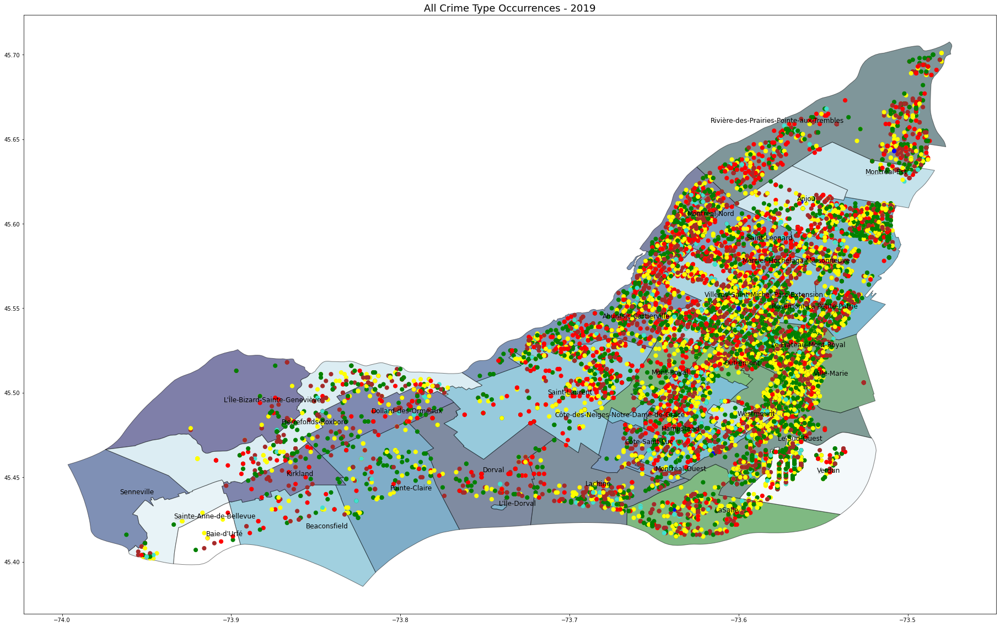

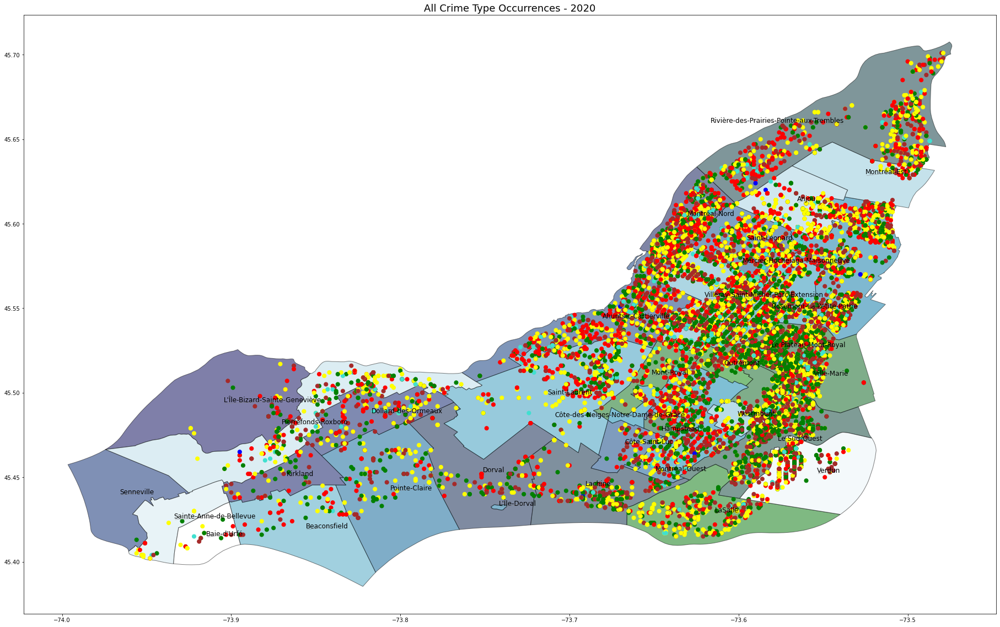

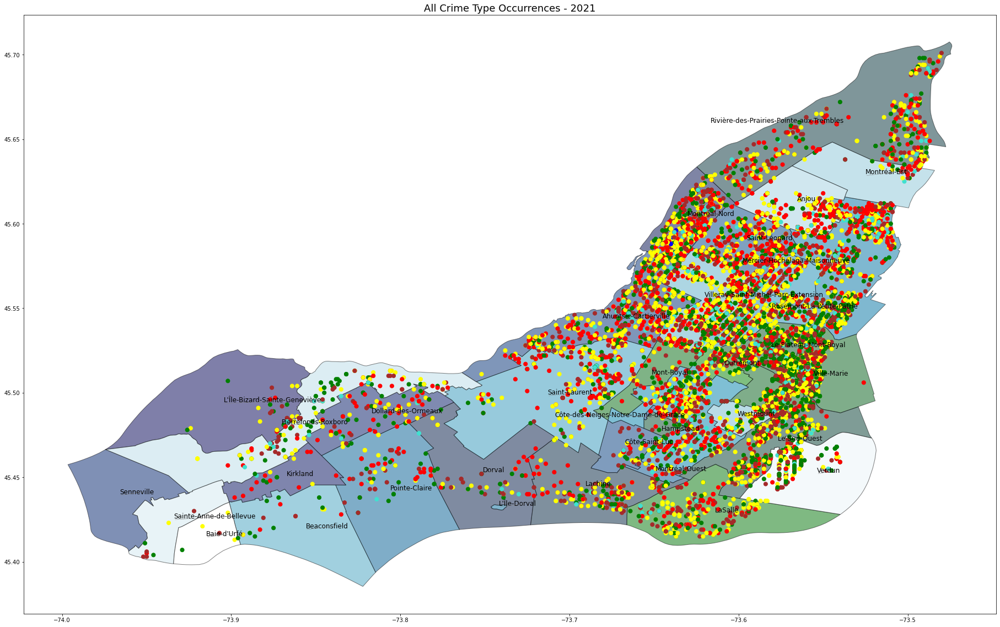

In [13]:
import json
import time
import geopandas as gpd
import adjustText as aT
import matplotlib
import matplotlib.pyplot as plt
from descartes import PolygonPatch
from shapely.geometry import LineString

for yr in df.year.unique():
    # obtain data for montreal boroughs map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    borough = gpd.read_file('limadmin-shp/montreal.json')
    borough = borough.to_crs(4326)
    borough["center"] = borough.to_crs('+proj=cea').centroid.to_crs(borough.crs)

    borough_points = borough.copy()
    borough_points.set_geometry("center", inplace = True)

    texts = []
    ax = borough.plot(column=None, cmap='ocean', edgecolor = "black", linewidth = 1, alpha=0.5, 
                      categorical=False, legend=False, ax=None, figsize=(40,20))
    # obtain data for montreal boroughs map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    # label all boroughs in montreal ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    for x, y, label in zip(borough_points.geometry.x, borough_points.geometry.y, borough_points["NOM"]):
        texts.append(plt.text(x, y, label, fontsize = 12))

    aT.adjust_text(texts, force_points=0.3, force_text=0.8, expand_points=(1,1), expand_text=(1,1), 
                   arrowprops=dict(arrowstyle="-", color='grey', lw=0.5))
    # label all boroughs in montreal ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    # obtain and plot crime data on map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    #yr=2017
    ax.set_title("All Crime Type Occurrences - " + str(yr), fontsize=18)
    
    gdf = gpd.GeoDataFrame(
        df[pd.DatetimeIndex(df['date']).year==yr], 
        geometry=gpd.points_from_xy(
            df[pd.DatetimeIndex(df['date']).year==yr].longitude, 
            df[pd.DatetimeIndex(df['date']).year==yr].latitude))

    crime_palette = {'Motor vehicle theft':'turquoise', 
        'Home Invasion': 'green', 
        'Mischief':'brown',
        'Theft in / from a motor vehicle':'red', 
        'Confirmed Theft':'blue',
        'Offenses resulting in death':'yellow'}

    cmap = matplotlib.colors.ListedColormap([crime_palette[b] for b in df.category.unique()])

    #gdf.plot(column='category', linewidth=2, ax=ax, alpha=0.5, legend=True, markersize=10, cmap=cmap)
    gdf.plot(ax=ax, column='category', cmap=cmap, markersize=50)
    plt.show()
    # obtain and plot crime data on map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

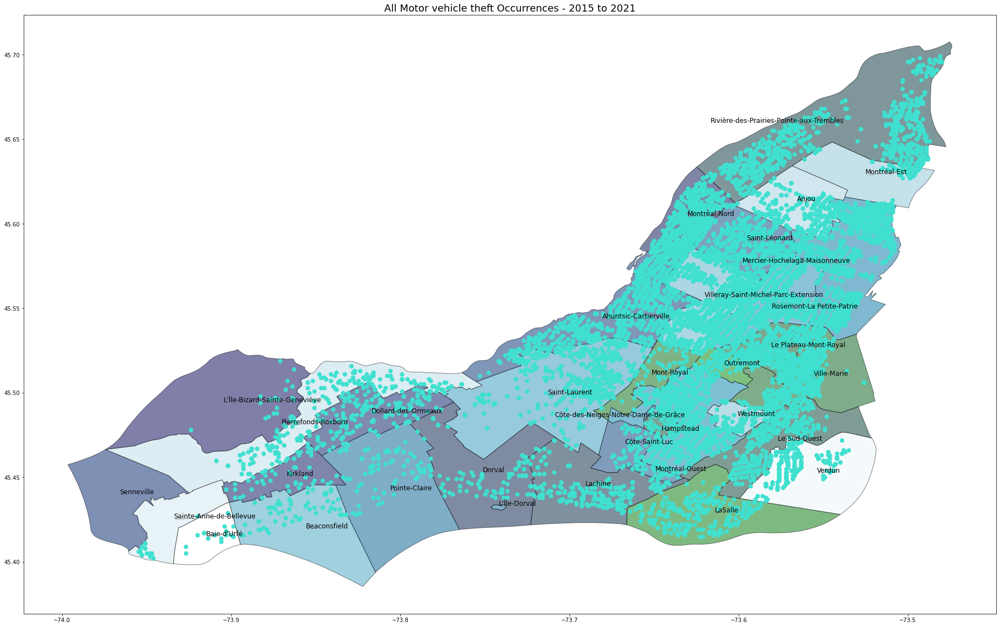

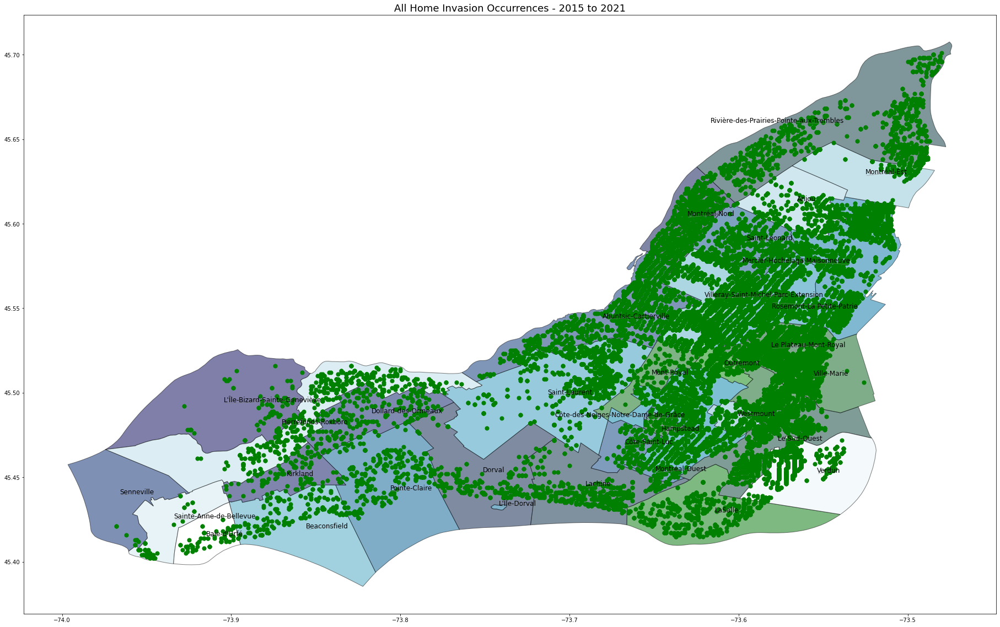

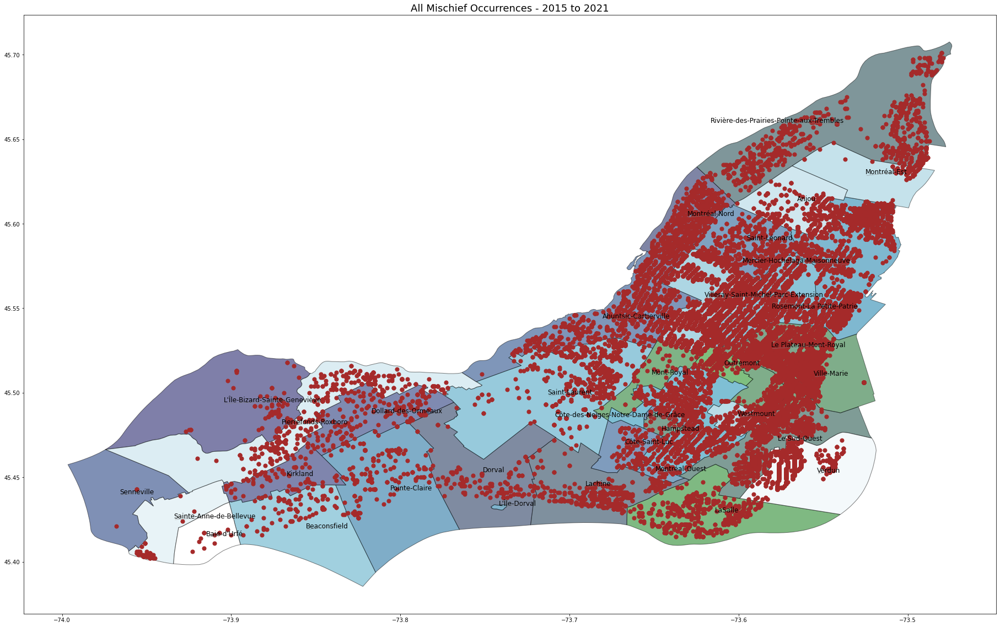

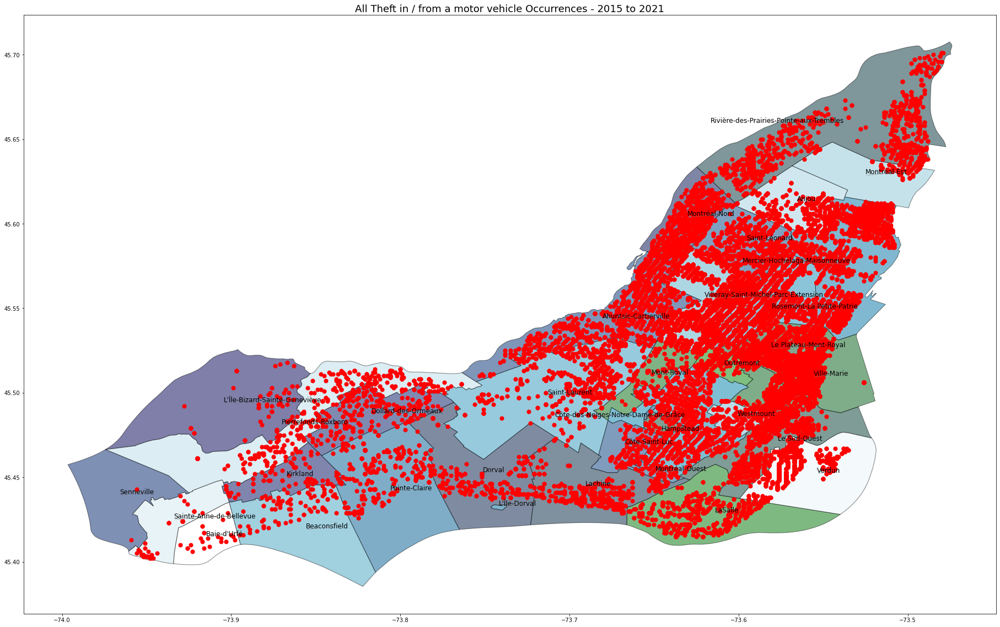

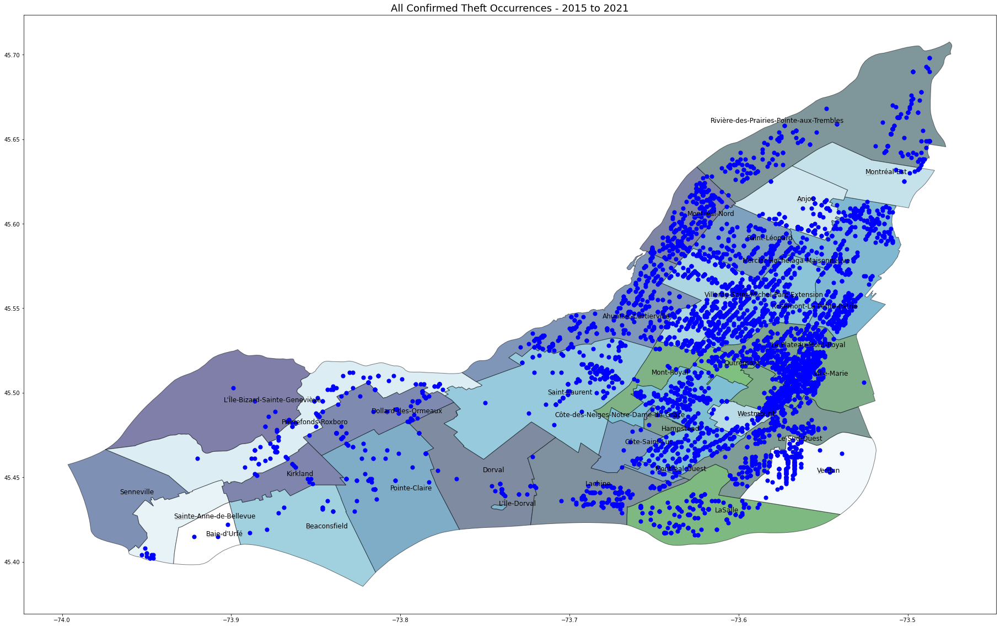

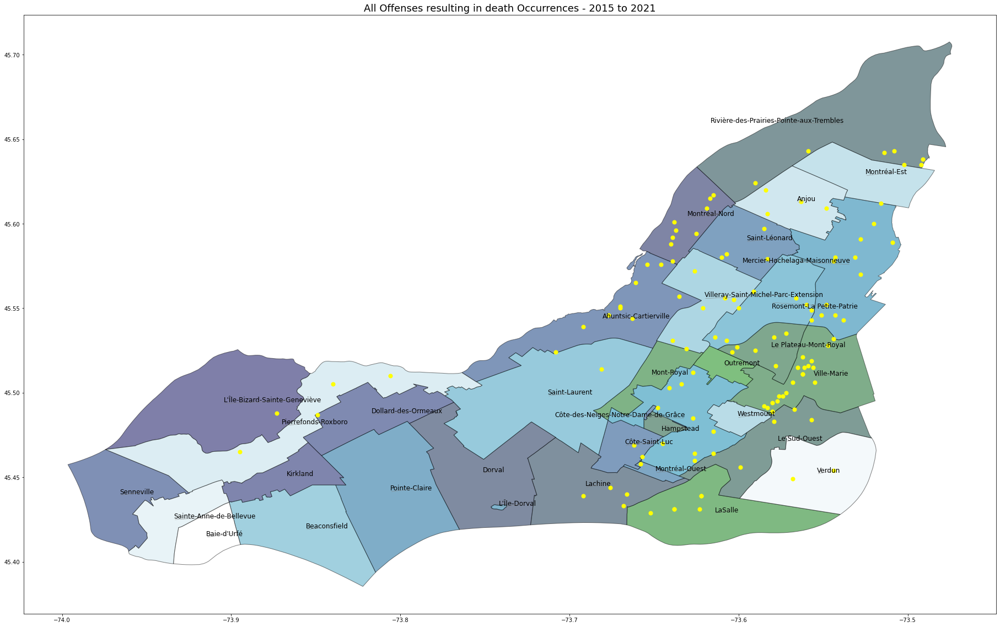

In [14]:
for crime in df.category.unique():
    # obtain data for montreal boroughs map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    borough = gpd.read_file('limadmin-shp/montreal.json')
    borough = borough.to_crs(4326)
    borough["center"] = borough.to_crs('+proj=cea').centroid.to_crs(borough.crs)

    borough_points = borough.copy()
    borough_points.set_geometry("center", inplace = True)

    texts = []
    ax = borough.plot(column=None, cmap='ocean', edgecolor = "black", linewidth = 1, alpha=0.5, 
                      categorical=False, legend=False, ax=None, figsize=(40,20))

    # obtain data for montreal boroughs map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    # label all boroughs in montreal ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    for x, y, label in zip(borough_points.geometry.x, borough_points.geometry.y, borough_points["NOM"]):
        texts.append(plt.text(x, y, label, fontsize = 12))

    aT.adjust_text(texts, force_points=0.3, force_text=0.8, expand_points=(1,1), expand_text=(1,1), 
                   arrowprops=dict(arrowstyle="-", color='grey', lw=0.5))
    # label all boroughs in montreal ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    # obtain and plot crime data on map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    #crime = 'Motor vehicle theft'
    ax.set_title("All " + crime + " Occurrences - 2015 to 2021", fontsize=18)

    gdf = gpd.GeoDataFrame(
        df[ (df.category==crime) ], 
        geometry=gpd.points_from_xy(
            df[ (df.category==crime) ].longitude, 
            df[ (df.category==crime) ].latitude))

    crime_palette = {'Motor vehicle theft':'turquoise', 
        'Home Invasion': 'green', 
        'Mischief':'brown',
        'Theft in / from a motor vehicle':'red', 
        'Confirmed Theft':'blue',
        'Offenses resulting in death':'yellow'}

    #cmap = matplotlib.colors.ListedColormap([crime_palette[b] for b in df.category.unique()])

    #gdf.plot(column='category', linewidth=2, ax=ax, alpha=0.5, legend=True, markersize=10, cmap=cmap)
    #gdf.plot(ax=ax, column='category', cmap=cmap, markersize=50)
    gdf.plot(ax=ax, color=crime_palette[crime], markersize=50)
    plt.show()
    # obtain and plot crime data on map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

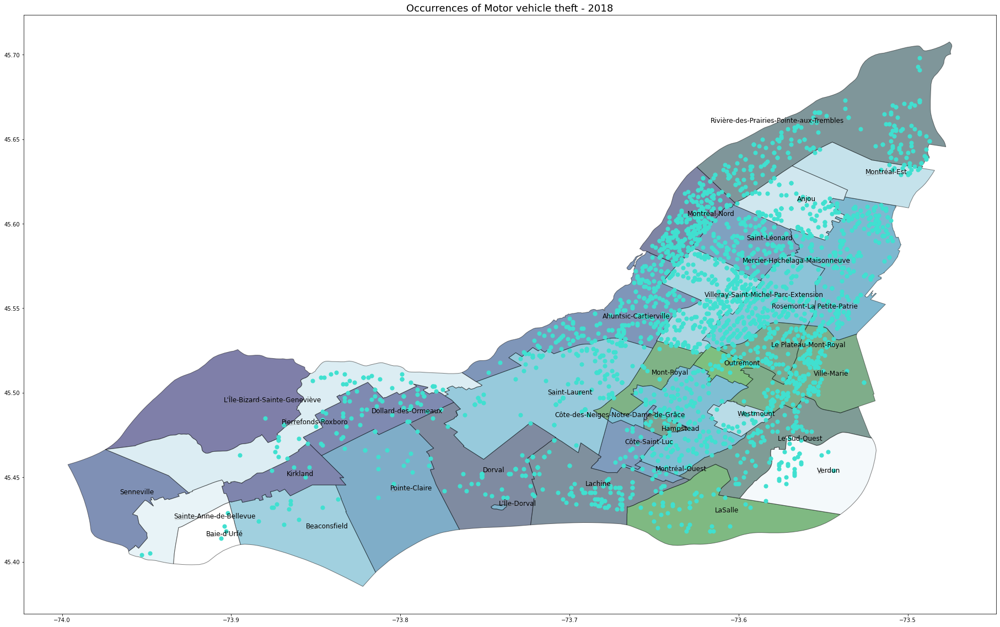

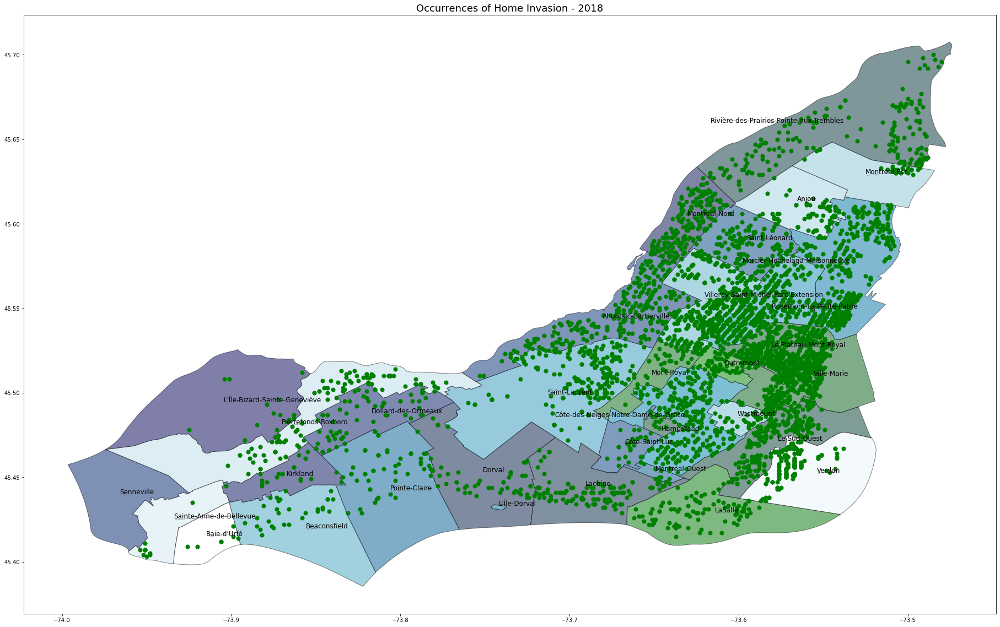

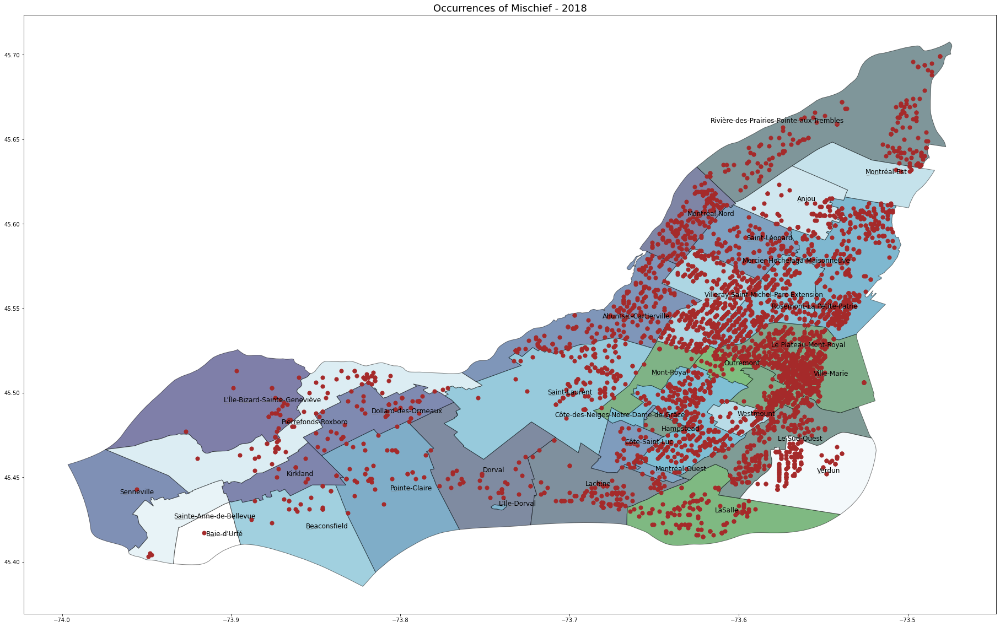

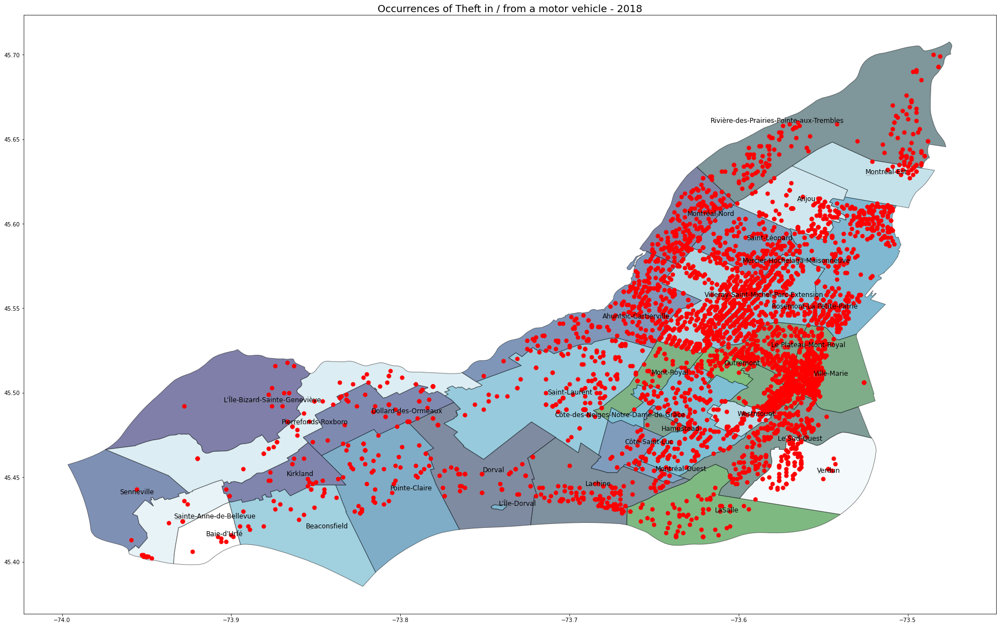

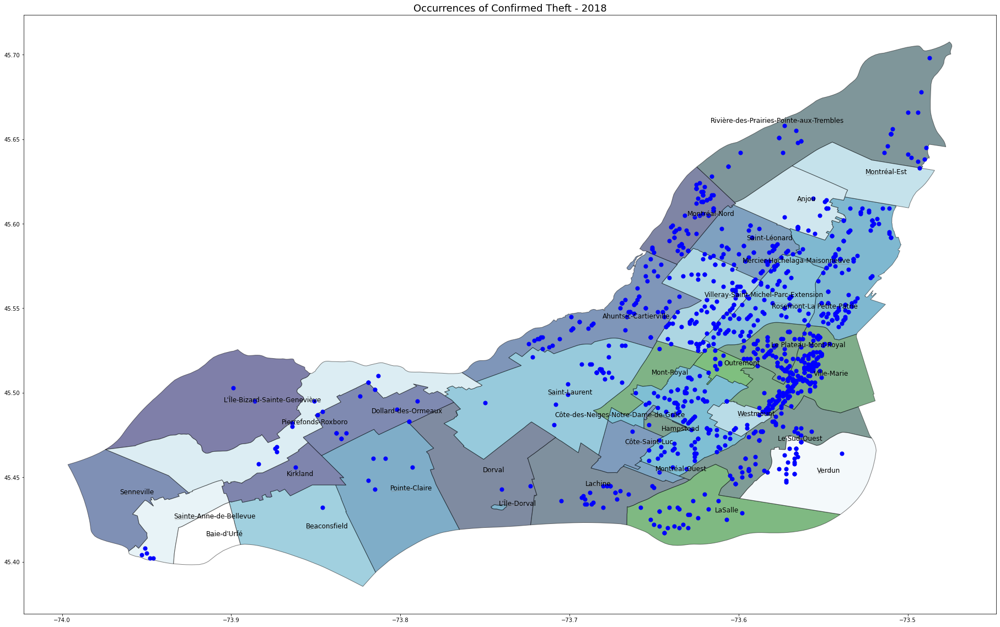

...

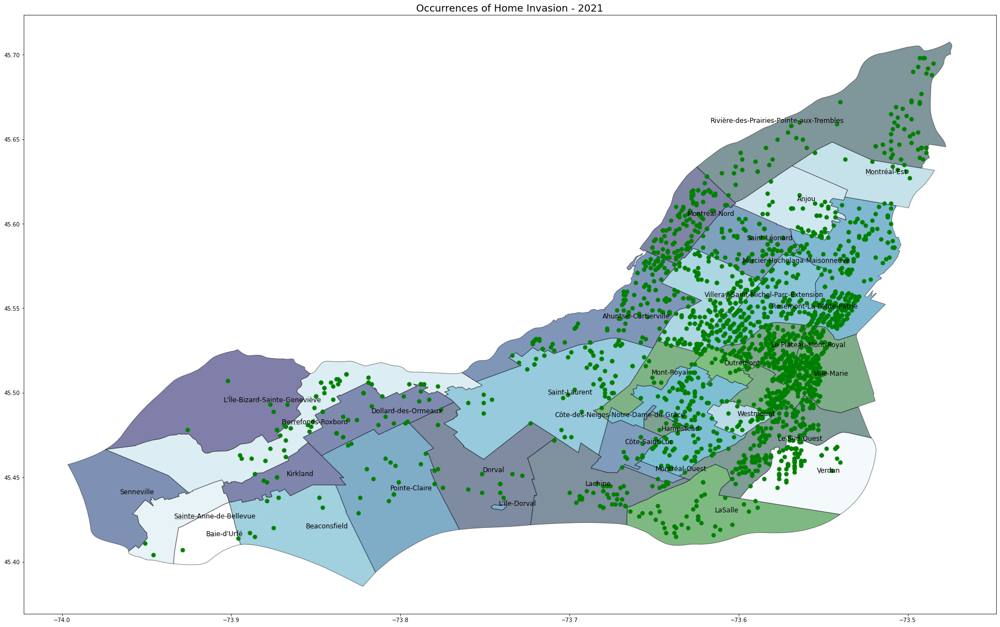

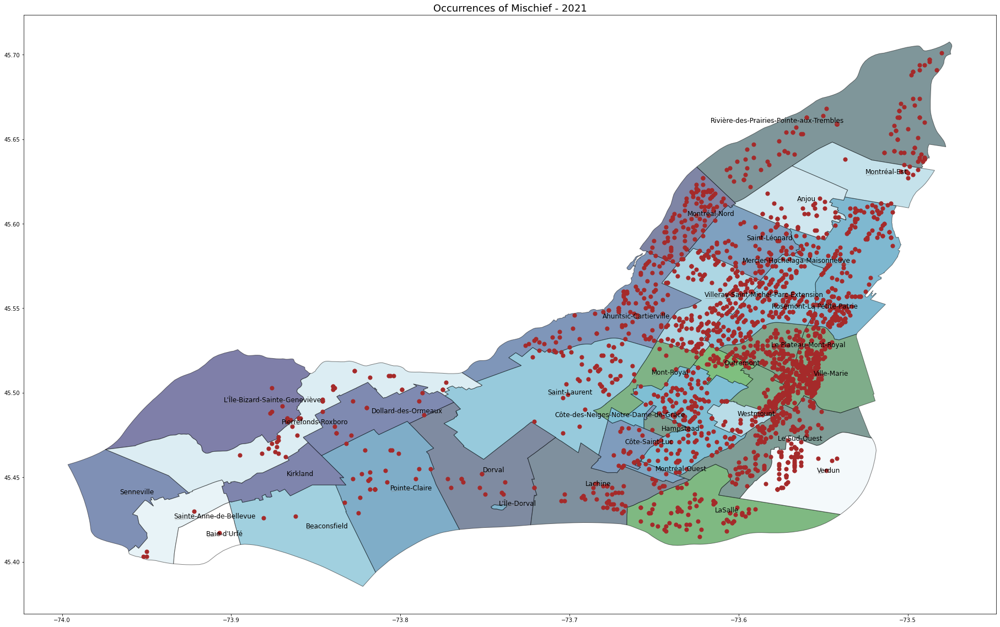

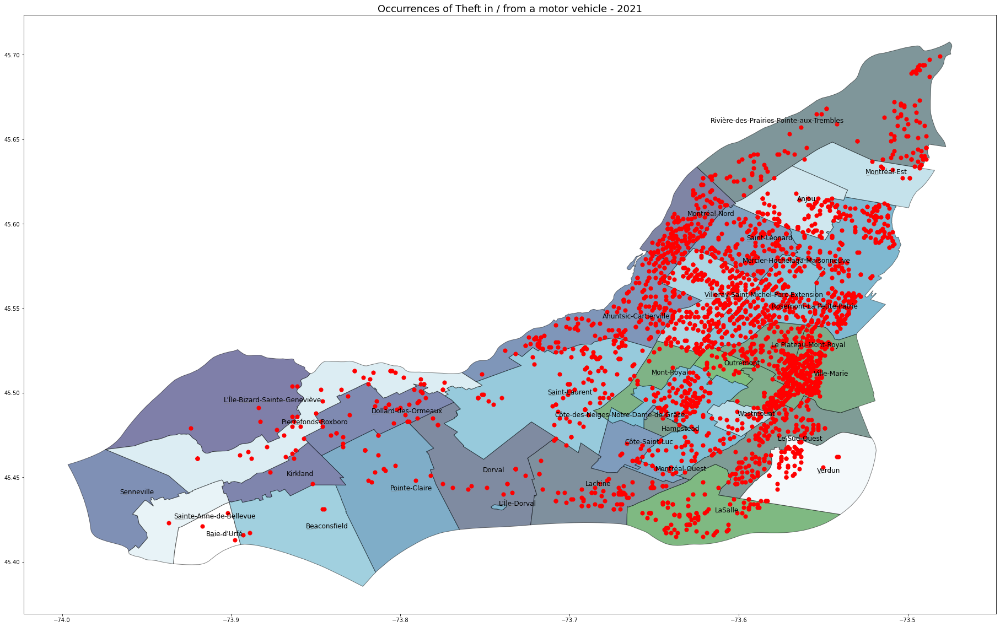

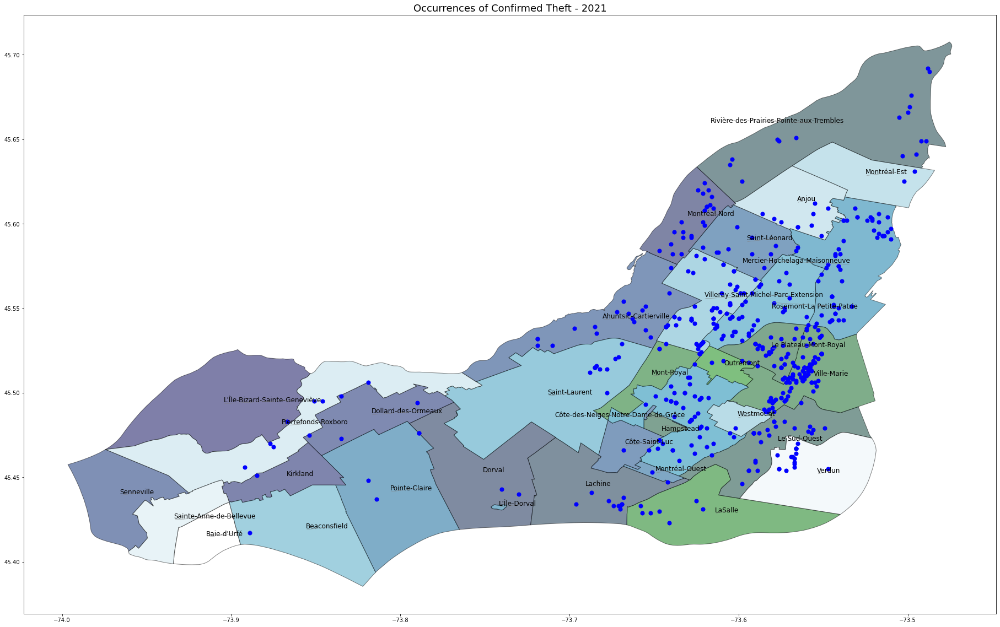

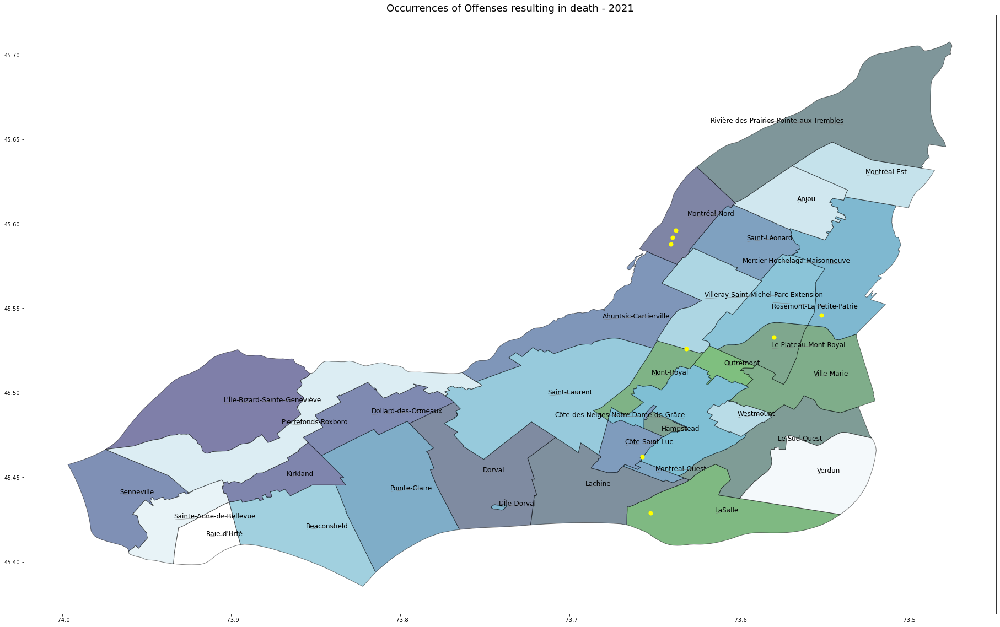

In [15]:
for yr in df.year.unique():
    for crime in df.category.unique():
        
        # obtain data for montreal boroughs map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        borough = gpd.read_file('limadmin-shp/montreal.json')
        borough = borough.to_crs(4326)
        borough["center"] = borough.to_crs('+proj=cea').centroid.to_crs(borough.crs)

        borough_points = borough.copy()
        borough_points.set_geometry("center", inplace = True)

        texts = []
        ax = borough.plot(column=None, cmap='ocean', edgecolor = "black", linewidth = 1, alpha=0.5, 
                          categorical=False, legend=False, ax=None, figsize=(40,20))
        # obtain data for montreal boroughs map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

        # label all boroughs in montreal ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        for x, y, label in zip(borough_points.geometry.x, borough_points.geometry.y, borough_points["NOM"]):
            texts.append(plt.text(x, y, label, fontsize = 12))

        aT.adjust_text(texts, force_points=0.3, force_text=0.8, expand_points=(1,1), expand_text=(1,1), 
                       arrowprops=dict(arrowstyle="-", color='grey', lw=0.5))
        # label all boroughs in montreal ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

        # obtain and plot crime data on map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        #yr=2017
        #crime = 'Motor vehicle theft'
        ax.set_title("Occurrences of " + crime + " - " + str(yr), fontsize=18)
        
        gdf = gpd.GeoDataFrame(
            df[ (pd.DatetimeIndex(df['date']).year==yr) & (df.category==crime) ], 
            geometry=gpd.points_from_xy(
                df[ (pd.DatetimeIndex(df['date']).year==yr) & (df.category==crime) ].longitude, 
                df[ (pd.DatetimeIndex(df['date']).year==yr) & (df.category==crime) ].latitude))

        crime_palette = {'Motor vehicle theft':'turquoise', 
            'Home Invasion': 'green', 
            'Mischief':'brown',
            'Theft in / from a motor vehicle':'red', 
            'Confirmed Theft':'blue',
            'Offenses resulting in death':'yellow'}

        #cmap = matplotlib.colors.ListedColormap([crime_palette[b] for b in df.category.unique()])

        #gdf.plot(column='category', linewidth=2, ax=ax, alpha=0.5, legend=True, markersize=10, cmap=cmap)
        #gdf.plot(ax=ax, column='category', cmap=cmap, markersize=50)
        gdf.plot(ax=ax, color=crime_palette[crime], markersize=50)
        plt.show()
        # obtain and plot crime data on map ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

In [85]:
def plotBorough( axes, name, fcolor, alpha ):
    # plot a borough on the provided axes
    nami = borough[borough.NOM == name]
    namigm = nami.__geo_interface__['features']  # geopandas's geo_interface
    namig0 = {'type': namigm[0]['geometry']['type'], \
              'coordinates': namigm[0]['geometry']['coordinates']}
    axes.add_patch(PolygonPatch( namig0, fc=fcolor, ec="black", alpha=alpha, zorder=2 ))

C:\Users\schou\anaconda3\envs\geo_env\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\schou\AppData\Local\Temp\ipykernel_5840\2210810352.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  borough["center"] = borough["geometry"].centroid.to_crs(borough.crs)


<function matplotlib.pyplot.show(close=None, block=None)>

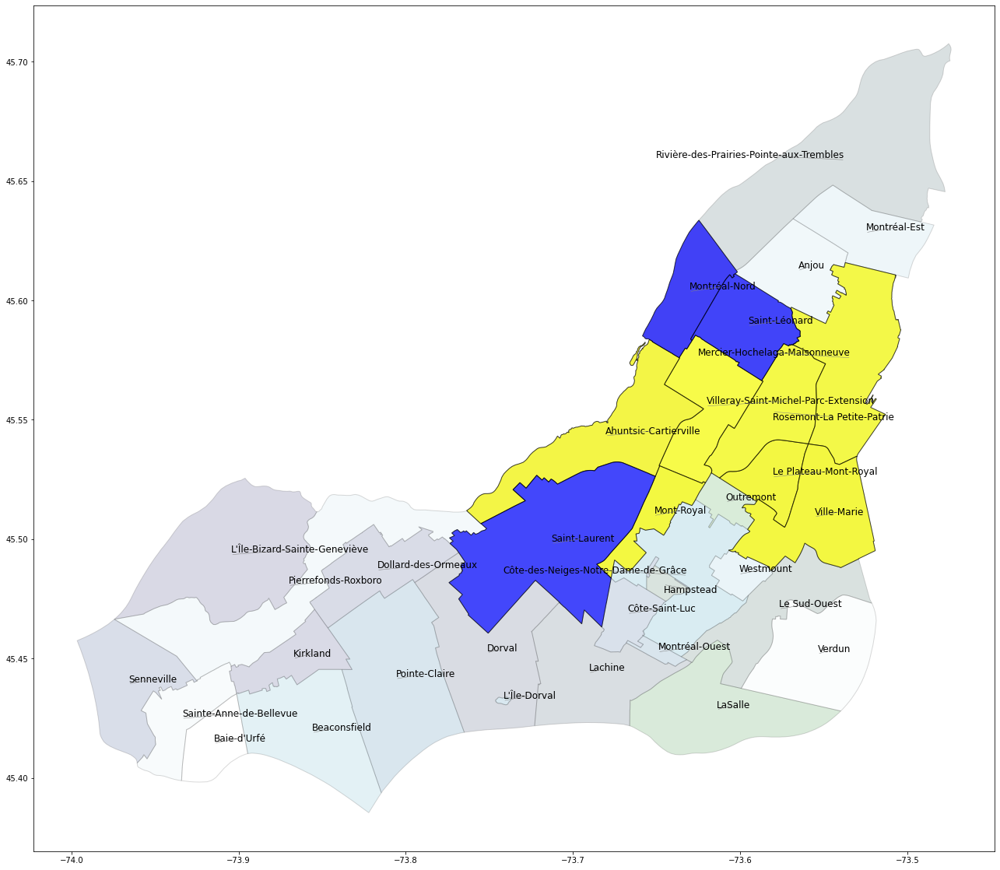

In [89]:
borough = gpd.read_file('limadmin-shp/montreal.json')
borough = borough.to_crs({'init': 'epsg:4326'})

borough["center"] = borough["geometry"].centroid.to_crs(borough.crs)

#borough["center"] = borough.to_crs('+proj=cea').centroid.to_crs(borough.crs)

borough_points = borough.copy()
borough_points.set_geometry("center", inplace = True)


texts = []

ax = borough.plot(cmap='ocean', column=None, edgecolor = "black", linewidth = 1, alpha=0.15, 
                  categorical=False, legend=False, ax=None, figsize=(40,20))

#ax = borough[borough.NOM == 'Ville-Marie'].plot(edgecolor=u'black', cmap='Pastel1')

# highlight specific boroughs of interest

montreal = ['Le Plateau-Mont-Royal', 'Villeray-Saint-Michel-Parc-Extension',
            'Rosemont-La Petite-Patrie',  'Mont-Royal',  'Ahuntsic-Cartierville',  'Mercier-Hochelaga-Maisonneuve',  'Ville-Marie']
others = ['Montréal-Nord', 'Saint-Laurent',  'Saint-Léonard']

for nom in montreal:
    plotBorough(ax, nom, 'yellow', 0.7)

for nom in others:
    plotBorough(ax, nom, 'blue', 0.7)
    
for x, y, label in zip(borough_points.geometry.x, borough_points.geometry.y, borough_points["NOM"]):
    texts.append(plt.text(x, y, label, fontsize = 12))

aT.adjust_text(texts, force_points=0.3, force_text=0.8, expand_points=(1,1), expand_text=(1,1), 
               arrowprops=dict(arrowstyle="-", color='grey', lw=0.5))


plt.show

In [79]:
borough[borough.NOM == 'Ville-Marie']

,NOM,TYPE,CODEID,ABREV,NUM,CODEMAMROT,AIRE,MUNID,PERIM,geometry,center
3,Ville-Marie,Arrondissement,9,VM,20,REM19,2.150063e+07,66023,26585.959852,"MULTIPOLYGON (((-73.53013 45.53476, -73.53543 ...",POINT (-73.55553 45.50933)


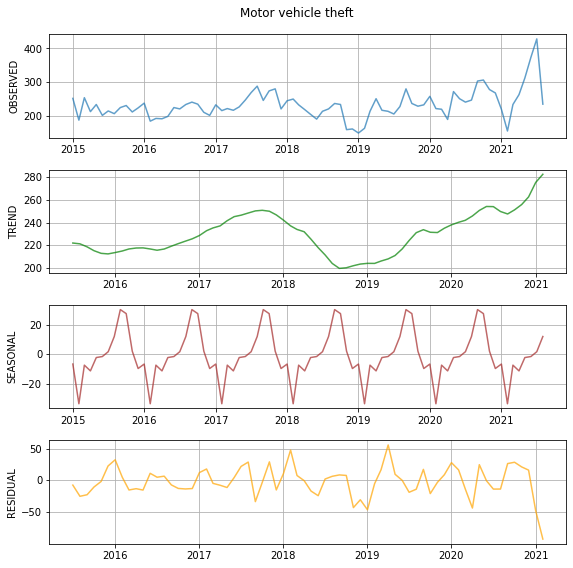

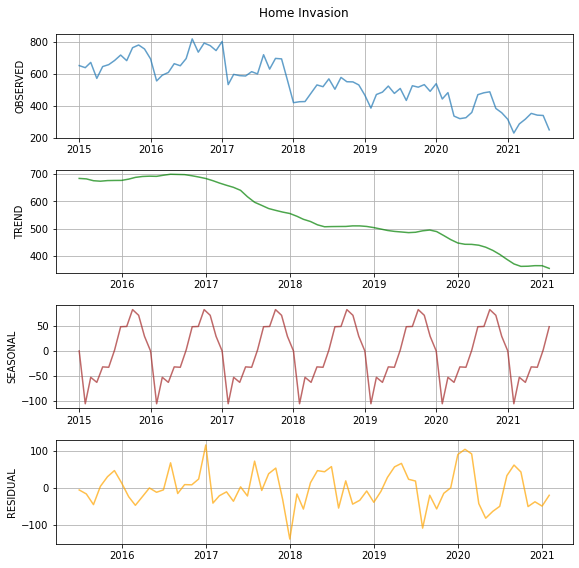

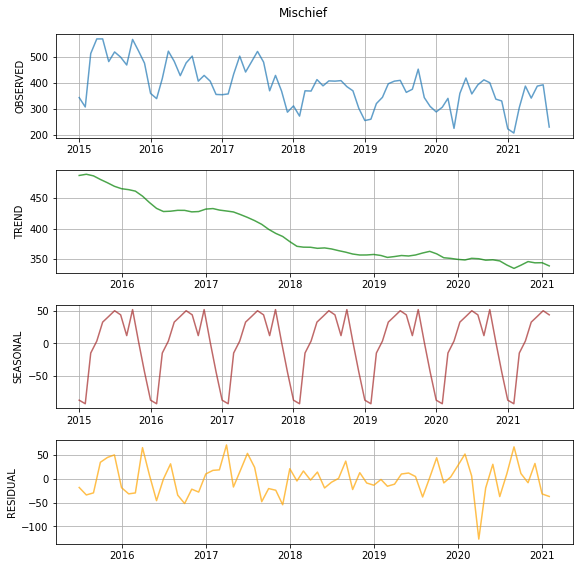

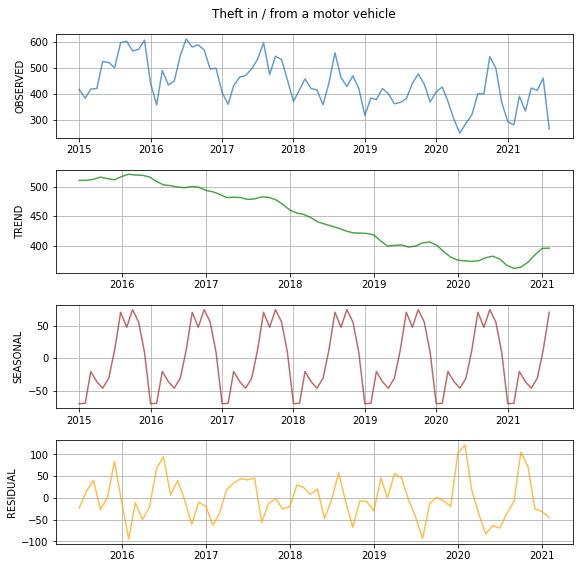

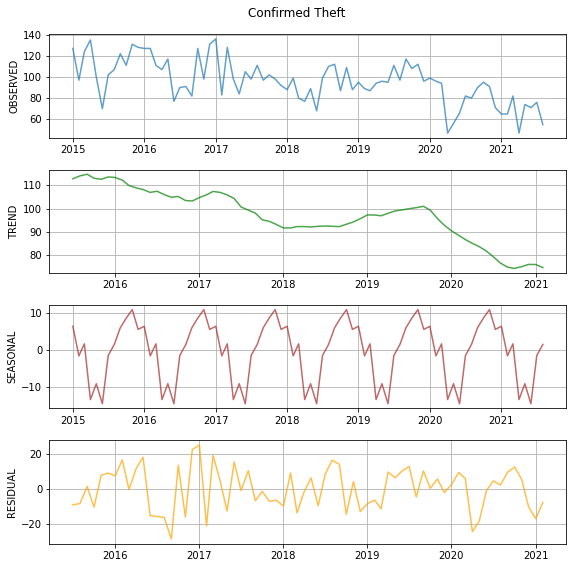

In [90]:
# ADDITIVE DECOMPOSITION
from statsmodels.tsa.seasonal import seasonal_decompose


for crime in df.category.unique():
    
    if crime == 'Offenses resulting in death':
        continue

    # set data by crime type and aggregate by month ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    # obtain select columns from original dataframe
    df2 = df.iloc[:,[1,2,7]].copy()
    df2 = df2[df2.category==crime]
    df2 = df2.iloc[:,[1,2]]
    # convert to datetime and reset 'day' to 1 for aggregating
    df2['date'] = pd.to_datetime(df2['date'])
    df2['date'] = df2.date.dt.to_period('M').dt.to_timestamp()
    # set date as index and then group occurence by month
    df2 = df2.set_index('date')
    df2 = df2.groupby(['date']).value_counts().unstack('count')
    df2.columns = [crime]
    # set data by crime type and aggregate by month ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    result = seasonal_decompose(df2[crime])
    #result = seasonal_decompose(df2[crime], model='multiplicative', period=1)

    # graph decomposition results ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    fig, ax = plt.subplots(4)
    fig.suptitle(crime)
    fig.set_figheight(8)
    fig.set_figwidth(8)
    fig.tight_layout()

    ax[0].plot(result.observed, alpha=0.7)
    ax[0].set_ylabel("OBSERVED")
    #ax[0].get_xaxis().set_visible(False)
    ax[0].grid()

    ax[1].plot(result.trend, color="green", alpha=0.7)
    ax[1].set_ylabel("TREND")
    #ax[1].get_xaxis().set_visible(False)
    ax[1].grid()

    ax[2].plot(result.seasonal, color="brown", alpha=0.7)
    ax[2].set_ylabel("SEASONAL")
    #ax[2].get_xaxis().set_visible(False)
    ax[2].grid()

    ax[3].plot(result.resid, color="orange", alpha=0.7)
    ax[3].set_ylabel("RESIDUAL")
    ax[3].grid()
    plt.show()
    # graph decomposition results ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

In [23]:
# statistical hypothesis test to detect non-stationarity to further test whether time series has trend
# if p-value is smaller than 0.05 then assume no trend -- reject null hypothesis (i.e., reject non-stationarity) and accept 
# alternative hypothesis (i.e., stationarity). 
from statsmodels.tsa.stattools import adfuller

for crime in df.category.unique():
    #crime = 'Mischief'
    df2 = df.iloc[:,[1,2,7]].copy()
    df2 = df2[df2.category==crime]
    df2 = df2.iloc[:,[1,2]]
    # convert to datetime and reset 'day' to 1 for aggregating
    df2['date'] = pd.to_datetime(df2['date'])
    df2['date']=df2.date.dt.to_period('M').dt.to_timestamp()
    # set date as index and then group occurence by month
    df2 = df2.set_index('date')
    df2 = df2.groupby(['date']).value_counts().unstack('count')
    df2.columns = [crime]

    adf, pval, usedlag, nobs, crit_vals, icbest =  adfuller(df2[crime].values)

    if pval < 0.05:
        trend = "No Trend / Non-Stationarity"
    else:
        trend = "Trend / Stationarity"

    print(crime, ":")
    print('\tADF test statistic:', adf)
    print('\tADF p-values:', pval, "  --", trend, "--")
    print('\tADF number of lags used:', usedlag)
    print('\tADF number of observations:', nobs)
    print('\tADF critical values:', crit_vals)
    print('\tADF best information criterion:', icbest, "\n")

Motor vehicle theft :
	ADF test statistic: -1.801868889172806
	ADF p-values: 0.3795342375642533   -- Trend / Stationarity --
	ADF number of lags used: 5
	ADF number of observations: 74
	ADF critical values: {'1%': -3.5219803175527606, '5%': -2.9014701097664504, '10%': -2.58807215485756}
	ADF best information criterion: 671.327199154093 

Home Invasion :
	ADF test statistic: 0.751384261524733
	ADF p-values: 0.9908094751189004   -- Trend / Stationarity --
	ADF number of lags used: 9
	ADF number of observations: 70
	ADF critical values: {'1%': -3.5274258688046647, '5%': -2.903810816326531, '10%': -2.5893204081632653}
	ADF best information criterion: 754.377477336493 

Mischief :
	ADF test statistic: -1.7530148915825658
	ADF p-values: 0.4040251324876547   -- Trend / Stationarity --
	ADF number of lags used: 11
	ADF number of observations: 68
	ADF critical values: {'1%': -3.530398990560757, '5%': -2.9050874099328317, '10%': -2.5900010121107266}
	ADF best information criterion: 718.396640534

C:\Users\schou\anaconda3\envs\geo_env\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\schou\anaconda3\envs\geo_env\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\schou\anaconda3\envs\geo_env\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\schou\anaconda3\envs\geo_env\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\schou\anaconda3\envs\geo_env\lib\site-p

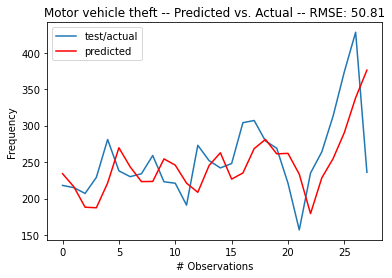

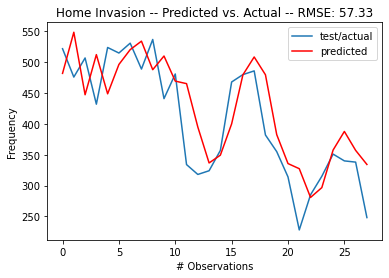

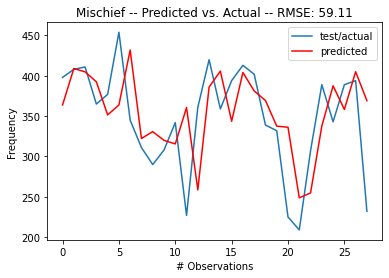

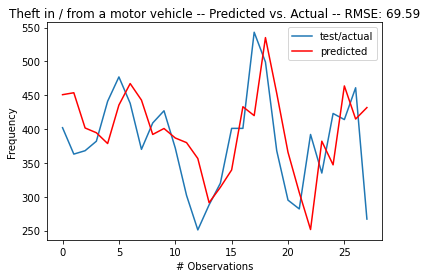

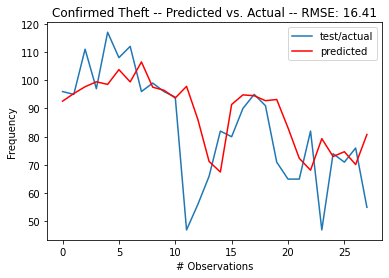

C:\Users\schou\anaconda3\envs\geo_env\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


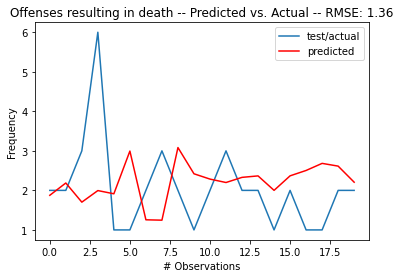

In [606]:
#from pandas import read_csv
#from pandas import datetime
from matplotlib import pyplot
from statsmodels.tsa.arima.model import ARIMA
#from statsmodels.tsa.statespace.sarimax import SARIMAX
#from statsmodels.tsa.holtwinters import ExponentialSmoothing
#from statsmodels.tsa.holtwinters import SimpleExpSmoothing
from sklearn.metrics import mean_squared_error
from math import sqrt

for crime in df.category.unique():
    
    #if crime == 'Offenses resulting in death':
    #    continue
    
    # set data by crime type and aggregate by month ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    # obtain select columns from original dataframe
    df2 = df.iloc[:,[1,2,7]].copy()
    df2 = df2[df2.category==crime]
    df2 = df2.iloc[:,[1,2]]
    # convert to datetime and reset 'day' to 1 for aggregating
    df2['date'] = pd.to_datetime(df2['date'])
    df2['date'] = df2.date.dt.to_period('M').dt.to_timestamp()
    # set date as index and then group occurence by month
    df2 = df2.set_index('date')
    df2 = df2.groupby(['date']).value_counts().unstack('count')
    df2.columns = [crime]
    # set data by crime type and aggregate by month ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    X = df2.values
    size = int(len(X) * 0.66)
    train, test = X[0:size], X[size:len(X)]
    history = [X for X in train]

    # ref: https://machinelearningmastery.com/time-series-forecasting-methods-in-python-cheat-sheet/
    # evaluate model using a walk-forward validatio


    X = df2.values
    size = int(len(X) * 0.66)
    train, test = X[0:size], X[size:len(X)]
    history = [x for x in train]
    predictions = list()

    for t in range(len(test)):
        #model = SARIMAX(history, order=(1, 1, 1), seasonal_order=(0, 0, 0, 0))
        #model = SimpleExpSmoothing(history)
        #model = ExponentialSmoothing(history)
        model = ARIMA(history, order=(5,1,1))
        model_fit = model.fit()
        output = model_fit.forecast()
        predictions.append(output[0])
        obs = test[t]
        history.append(obs)
        #print('predicted=%f, expected=%f' % (yhat, obs))

    # evaluate forecasts and plot forecasts ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    rmse = sqrt(mean_squared_error(test, predictions))
    #print(crime, ' -- Test RMSE: %.3f' % rmse)

    plt.plot(test, label='test/actual')
    plt.plot(predictions, color='red', label='predicted')
    plt.legend(loc="best")
    plt.xlabel("# Observations")
    plt.ylabel("Frequency")
    plt.title(crime + ' -- Predicted vs. Actual -- RMSE: ' + "{:.2f}".format(rmse))
    plt.show()
    # evaluate forecasts and plot forecasts ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


In [603]:
# model_fit.summary()

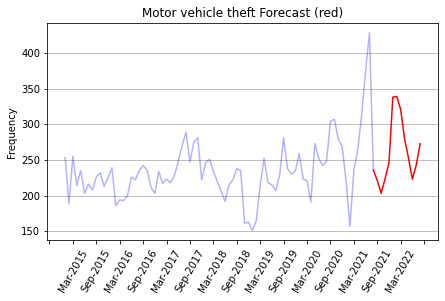

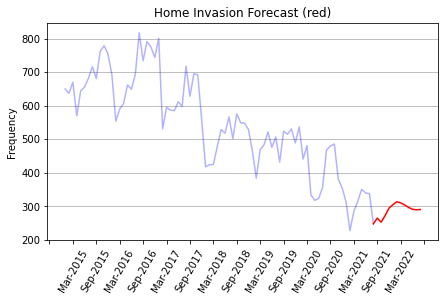

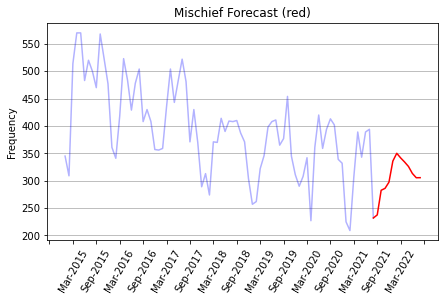

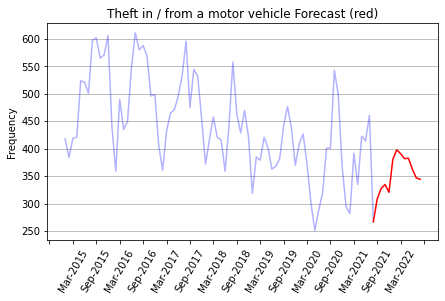

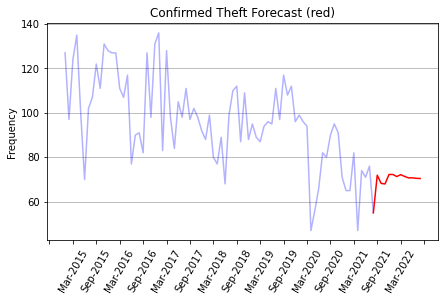

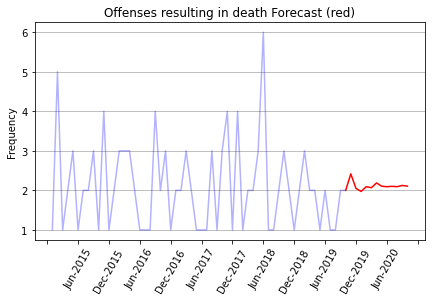

In [583]:
from pandas import read_csv
#from pandas import datetime
from matplotlib import pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
from math import sqrt
import datetime as dt
import matplotlib.dates as mdates
#import matplotlib.pylab as plt

for crime in df.category.unique():
        
    # set data by crime type and aggregate by month ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    # obtain select columns from original dataframe
    df2 = df.iloc[:,[1,2,7]].copy()
    df2 = df2[df2.category==crime]
    df2 = df2.iloc[:,[1,2]]
    # convert to datetime and reset 'day' to 1 for aggregating
    df2['date'] = pd.to_datetime(df2['date'])
    df2['date'] = df2.date.dt.to_period('M').dt.to_timestamp()
    # set date as index and then group occurence by month
    df2 = df2.set_index('date')
    df2 = df2.groupby(['date']).value_counts().unstack('count')
    df2.columns = [crime]
    # set data by crime type and aggregate by month ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    
    # predict ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    history = list( (df2.values).flatten() )
    start = len(history)

    for t in range(0,12):
        model = ARIMA(history, order=(5,1,1))
        model_fit = model.fit()
        output = model_fit.forecast()
        history.append(output[0])

    # predict ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    # create plot ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    months = pd.date_range(start='2015-01-01', periods=len(history), freq='M')
    months = months.strftime('%b-%Y')

    results = pd.DataFrame(list(zip(months, history)), columns=['date', crime])

    ax = (results[crime][:start]).plot(color='blue', rot=60, alpha=0.3, figsize=(7,4))
    ax = (results[crime][start-1:]).plot(color='red', rot=60)
    ax.grid('on', which='major', axis='y' )

    ax.set_title(crime + " Forecast (red)")
    ax.set_ylabel("Frequency")

    ax.set_xticks(range(len(results)))
    ax.set_xticklabels(results.date)
    ax.xaxis.set_major_locator(mdates.DayLocator(interval=6))
    plt.show()
    # create plot ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~